In [ ]:
!python --version

Python 3.9.16


In [2]:
''' import packages '''

import pandas as pd
import os
import sys
import numpy as np
import tqdm 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.model_selection import train_test_split, KFold
from sklearn.ensemble import RandomForestClassifier, VotingClassifier, StackingClassifier
from sklearn.metrics import f1_score, recall_score, precision_score, confusion_matrix, classification_report
from xgboost import XGBRFClassifier
import warnings
warnings.filterwarnings('ignore')
from imblearn.over_sampling import SMOTE
from lightgbm import LGBMClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
import matplotlib.dates as mdates

## For feature generation
sys.path.append("/content/drive/MyDrive/George B. Moody PhysioNet Challenge/Notebooks/competition notebooks")

import moody32_frequency_features
from moody32_frequency_features import frequency_features

import moody3_stats_features
from moody3_stats_features import statistical_features 


### File Read and Feature Generation

In [3]:
# pip install wfdb
import wfdb

ModuleNotFoundError: ignored

In [8]:
path_root = r'/content/drive/MyDrive/George B. Moody PhysioNet Challenge/Data/Raw Data/i-care-international-cardiac-arrest-research-consortium-database-1.0/training'

In [4]:
# Find the folders with data files.
def find_data_folders(root_folder):
    data_folders = list()
    for x in os.listdir(root_folder):
        data_folder = os.path.join(root_folder, x)
        if os.path.isdir(data_folder):
            data_folders.append(x)
    return sorted(data_folders) 

In [9]:
data_folders =find_data_folders(path_root)
# data_folders 

In [10]:
len(data_folders)

607

In [11]:
def patient_metadata(patient_metadata_file):
    df_txt = pd.read_csv(patient_metadata_file, sep=':', header = None)
    df_txt[0] = df_txt[0].str.strip() 
    df_txt[1] = df_txt[1].str.strip() 
    df_txt = df_txt.T
    df_txt.columns = df_txt.loc[0]
    df_txt = df_txt[1:]
    df_txt.reset_index(drop= True, inplace = True)
    return df_txt

In [ ]:
# com_path = r'/content/drive/MyDrive/George B. Moody PhysioNet Challenge/Data/Raw Data/i-care-international-cardiac-arrest-research-consortium-database-1.0/Combined_df'

In [ ]:
# path_w = '/content/drive/MyDrive/George B. Moody PhysioNet Challenge/Data/Raw Data/i-care-international-cardiac-arrest-research-consortium-database-1.0/stat_features'

In [12]:
from google.colab import output

In [13]:

def _feat_gen(data_folders):
    for patient_id in data_folders:
        comb_df = pd.DataFrame()
        print('This is for',patient_id)
        # Define file location.
        patient_metadata_file = os.path.join(path_root, patient_id, patient_id + '.txt')
        recording_metadata_file = os.path.join(path_root, patient_id, patient_id + '.tsv')
        df_rec_met = pd.read_csv(recording_metadata_file, sep='\t')
        df_rec_met.dropna(inplace= True)
        df_rec_met.reset_index(drop= True, inplace= True)
        df_pat_met = patient_metadata(patient_metadata_file)

        for ind,patient_id_sub in enumerate(df_rec_met['Record']):
            print(patient_id_sub)
            record1 =wfdb.rdrecord(os.path.join(path_root,patient_id, patient_id_sub))
            df= pd.DataFrame(record1.p_signal)
            df.columns = record1.sig_name
            for col in df_rec_met.columns:
                df[col] = df_rec_met[col][ind]
            comb_df = pd.concat([comb_df, df])
        
        for col1 in df_pat_met.columns:
            comb_df[col1] = df_pat_met[col1][0]

                        
        
        # comb_df.to_csv(os.path.join(com_path, patient_id+'.csv'))
        comb_df.reset_index(drop=True,inplace=True)
        statistical_feature  = statistical_features(comb_df)
        freq_feature  = frequency_features(comb_df)

        df_all =freq_feature.merge(statistical_feature, on=['Hour', 'Time', 'Quality', 'Record', 'Patient', 'Age', 'Sex', 'ROSC',
        'OHCA', 'VFib', 'TTM', 'Outcome', 'CPC'] )

        # path_write = os.path.join(path_w,patient_id+'_stat.csv')
        # statistical_feature.to_csv(path_write, index= False)

        print("done")
        output.clear()

        return df_all



### Appending feature paths

In [14]:
paths=[]
for roots,dirs,files in os.walk('/content/drive/MyDrive/George B. Moody PhysioNet Challenge/Data/Raw Data/i-care-international-cardiac-arrest-research-consortium-database-1.0/combined_features'):
    for file1 in files:
        pathr= os.path.join(roots,file1)
        # print(pathr)
        paths.extend([pathr])

### Concating all feature files to single dataframe

In [15]:
df = pd.DataFrame()
for path1 in paths:
    dfr=pd.read_csv(path1)
   
    
    df = pd.concat([df, dfr])
    



In [16]:
df.columns

Index(['Fp1-F7_Fp1-F7_totpowr', 'Fp1-F7_Fp1-F7_deltapowr',
       'Fp1-F7_Fp1-F7_thetapowr', 'Fp1-F7_Fp1-F7_alfapowr',
       'Fp1-F7_Fp1-F7_betapowr', 'Fp1-F7_Fp1-F7_gamapowr',
       'Fp1-F7_Fp1-F7_deltapowr_r', 'Fp1-F7_Fp1-F7_thetapowr_r',
       'Fp1-F7_Fp1-F7_alfapowr_r', 'Fp1-F7_Fp1-F7_betapowr_r',
       ...
       'Cz-Pz_max', 'Cz-Pz_skew', 'Cz-Pz_kurtosis', 'Cz-Pz_energy',
       'Cz-Pz_moment1', 'Cz-Pz_moment2', 'Cz-Pz_moment3', 'Cz-Pz_moment4',
       'Cz-Pz_amplitude', 'Cz-Pz_entropy'],
      dtype='object', length=517)

##### Concat reconstruction loss

In [ ]:
df.shape

(23528, 517)

In [17]:
col_list = ['Hour', 'Time', 'Quality', 'Record', 'Patient', 'Age', 'Sex', 'ROSC',
       'OHCA', 'VFib', 'TTM', 'Outcome', 'CPC'] 

In [18]:
df_group = df.groupby(by='Patient') ### creating groupby object to extract subject wise dataframes

In [19]:
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 1000)

In [20]:
df.head()

,Fp1-F7_Fp1-F7_totpowr,Fp1-F7_Fp1-F7_deltapowr,Fp1-F7_Fp1-F7_thetapowr,Fp1-F7_Fp1-F7_alfapowr,Fp1-F7_Fp1-F7_betapowr,Fp1-F7_Fp1-F7_gamapowr,Fp1-F7_Fp1-F7_deltapowr_r,Fp1-F7_Fp1-F7_thetapowr_r,Fp1-F7_Fp1-F7_alfapowr_r,Fp1-F7_Fp1-F7_betapowr_r,Fp1-F7_Fp1-F7_gamapowr_r,Fp1-F7_Fp1-F7_spectral_ent,F7-T3_F7-T3_totpowr,F7-T3_F7-T3_deltapowr,F7-T3_F7-T3_thetapowr,F7-T3_F7-T3_alfapowr,F7-T3_F7-T3_betapowr,F7-T3_F7-T3_gamapowr,F7-T3_F7-T3_deltapowr_r,F7-T3_F7-T3_thetapowr_r,F7-T3_F7-T3_alfapowr_r,F7-T3_F7-T3_betapowr_r,F7-T3_F7-T3_gamapowr_r,F7-T3_F7-T3_spectral_ent,T3-T5_T3-T5_totpowr,T3-T5_T3-T5_deltapowr,T3-T5_T3-T5_thetapowr,T3-T5_T3-T5_alfapowr,T3-T5_T3-T5_betapowr,T3-T5_T3-T5_gamapowr,T3-T5_T3-T5_deltapowr_r,T3-T5_T3-T5_thetapowr_r,T3-T5_T3-T5_alfapowr_r,T3-T5_T3-T5_betapowr_r,T3-T5_T3-T5_gamapowr_r,T3-T5_T3-T5_spectral_ent,T5-O1_T5-O1_totpowr,T5-O1_T5-O1_deltapowr,T5-O1_T5-O1_thetapowr,T5-O1_T5-O1_alfapowr,T5-O1_T5-O1_betapowr,T5-O1_T5-O1_gamapowr,T5-O1_T5-O1_deltapowr_r,T5-O1_T5-O1_thetapowr_r,T5-O1_T5-O1_alfapowr_r,T5-O1_T5-O1_betapowr_r,T5-O1_T5-O1_gamapowr_r,T5-O1_T5-O1_spectral_ent,Fp2-F8_Fp2-F8_totpowr,Fp2-F8_Fp2-F8_deltapowr,Fp2-F8_Fp2-F8_thetapowr,Fp2-F8_Fp2-F8_alfapowr,Fp2-F8_Fp2-F8_betapowr,Fp2-F8_Fp2-F8_gamapowr,Fp2-F8_Fp2-F8_deltapowr_r,Fp2-F8_Fp2-F8_thetapowr_r,Fp2-F8_Fp2-F8_alfapowr_r,Fp2-F8_Fp2-F8_betapowr_r,Fp2-F8_Fp2-F8_gamapowr_r,Fp2-F8_Fp2-F8_spectral_ent,F8-T4_F8-T4_totpowr,F8-T4_F8-T4_deltapowr,F8-T4_F8-T4_thetapowr,F8-T4_F8-T4_alfapowr,F8-T4_F8-T4_betapowr,F8-T4_F8-T4_gamapowr,F8-T4_F8-T4_deltapowr_r,F8-T4_F8-T4_thetapowr_r,F8-T4_F8-T4_alfapowr_r,F8-T4_F8-T4_betapowr_r,F8-T4_F8-T4_gamapowr_r,F8-T4_F8-T4_spectral_ent,T4-T6_T4-T6_totpowr,T4-T6_T4-T6_deltapowr,T4-T6_T4-T6_thetapowr,T4-T6_T4-T6_alfapowr,T4-T6_T4-T6_betapowr,T4-T6_T4-T6_gamapowr,T4-T6_T4-T6_deltapowr_r,T4-T6_T4-T6_thetapowr_r,T4-T6_T4-T6_alfapowr_r,T4-T6_T4-T6_betapowr_r,T4-T6_T4-T6_gamapowr_r,T4-T6_T4-T6_spectral_ent,T6-O2_T6-O2_totpowr,T6-O2_T6-O2_deltapowr,T6-O2_T6-O2_thetapowr,T6-O2_T6-O2_alfapowr,T6-O2_T6-O2_betapowr,T6-O2_T6-O2_gamapowr,T6-O2_T6-O2_deltapowr_r,T6-O2_T6-O2_thetapowr_r,T6-O2_T6-O2_alfapowr_r,T6-O2_T6-O2_betapowr_r,T6-O2_T6-O2_gamapowr_r,T6-O2_T6-O2_spectral_ent,Fp1-F3_Fp1-F3_totpowr,Fp1-F3_Fp1-F3_deltapowr,Fp1-F3_Fp1-F3_thetapowr,Fp1-F3_Fp1-F3_alfapowr,Fp1-F3_Fp1-F3_betapowr,Fp1-F3_Fp1-F3_gamapowr,Fp1-F3_Fp1-F3_deltapowr_r,Fp1-F3_Fp1-F3_thetapowr_r,Fp1-F3_Fp1-F3_alfapowr_r,Fp1-F3_Fp1-F3_betapowr_r,Fp1-F3_Fp1-F3_gamapowr_r,Fp1-F3_Fp1-F3_spectral_ent,F3-C3_F3-C3_totpowr,F3-C3_F3-C3_deltapowr,F3-C3_F3-C3_thetapowr,F3-C3_F3-C3_alfapowr,F3-C3_F3-C3_betapowr,F3-C3_F3-C3_gamapowr,F3-C3_F3-C3_deltapowr_r,F3-C3_F3-C3_thetapowr_r,F3-C3_F3-C3_alfapowr_r,F3-C3_F3-C3_betapowr_r,F3-C3_F3-C3_gamapowr_r,F3-C3_F3-C3_spectral_ent,C3-P3_C3-P3_totpowr,C3-P3_C3-P3_deltapowr,C3-P3_C3-P3_thetapowr,C3-P3_C3-P3_alfapowr,C3-P3_C3-P3_betapowr,C3-P3_C3-P3_gamapowr,C3-P3_C3-P3_deltapowr_r,C3-P3_C3-P3_thetapowr_r,C3-P3_C3-P3_alfapowr_r,C3-P3_C3-P3_betapowr_r,C3-P3_C3-P3_gamapowr_r,C3-P3_C3-P3_spectral_ent,P3-O1_P3-O1_totpowr,P3-O1_P3-O1_deltapowr,P3-O1_P3-O1_thetapowr,P3-O1_P3-O1_alfapowr,P3-O1_P3-O1_betapowr,P3-O1_P3-O1_gamapowr,P3-O1_P3-O1_deltapowr_r,P3-O1_P3-O1_thetapowr_r,P3-O1_P3-O1_alfapowr_r,P3-O1_P3-O1_betapowr_r,P3-O1_P3-O1_gamapowr_r,P3-O1_P3-O1_spectral_ent,Fp2-F4_Fp2-F4_totpowr,Fp2-F4_Fp2-F4_deltapowr,Fp2-F4_Fp2-F4_thetapowr,Fp2-F4_Fp2-F4_alfapowr,Fp2-F4_Fp2-F4_betapowr,Fp2-F4_Fp2-F4_gamapowr,Fp2-F4_Fp2-F4_deltapowr_r,Fp2-F4_Fp2-F4_thetapowr_r,Fp2-F4_Fp2-F4_alfapowr_r,Fp2-F4_Fp2-F4_betapowr_r,Fp2-F4_Fp2-F4_gamapowr_r,Fp2-F4_Fp2-F4_spectral_ent,F4-C4_F4-C4_totpowr,F4-C4_F4-C4_deltapowr,F4-C4_F4-C4_thetapowr,F4-C4_F4-C4_alfapowr,F4-C4_F4-C4_betapowr,F4-C4_F4-C4_gamapowr,F4-C4_F4-C4_deltapowr_r,F4-C4_F4-C4_thetapowr_r,F4-C4_F4-C4_alfapowr_r,F4-C4_F4-C4_betapowr_r,F4-C4_F4-C4_gamapowr_r,F4-C4_F4-C4_spectral_ent,C4-P4_C4-P4_totpowr,C4-P4_C4-P4_deltapowr,C4-P4_C4-P4_thetapowr,C4-P4_C4-P4_alfapowr,C4-P4_C4-P4_betapowr,C4-P4_C4-P4_gamapowr,C4-P4_C4-P

In [21]:
df.isna().sum()

Fp1-F7_Fp1-F7_totpowr             0
Fp1-F7_Fp1-F7_deltapowr           0
Fp1-F7_Fp1-F7_thetapowr           0
Fp1-F7_Fp1-F7_alfapowr            0
Fp1-F7_Fp1-F7_betapowr            0
Fp1-F7_Fp1-F7_gamapowr            0
Fp1-F7_Fp1-F7_deltapowr_r       293
Fp1-F7_Fp1-F7_thetapowr_r       293
Fp1-F7_Fp1-F7_alfapowr_r        293
Fp1-F7_Fp1-F7_betapowr_r        293
Fp1-F7_Fp1-F7_gamapowr_r        293
Fp1-F7_Fp1-F7_spectral_ent      293
F7-T3_F7-T3_totpowr               0
F7-T3_F7-T3_deltapowr             0
F7-T3_F7-T3_thetapowr             0
F7-T3_F7-T3_alfapowr              0
F7-T3_F7-T3_betapowr              0
F7-T3_F7-T3_gamapowr              0
F7-T3_F7-T3_deltapowr_r         289
F7-T3_F7-T3_thetapowr_r         289
F7-T3_F7-T3_alfapowr_r          289
F7-T3_F7-T3_betapowr_r          289
F7-T3_F7-T3_gamapowr_r          289
F7-T3_F7-T3_spectral_ent        289
T3-T5_T3-T5_totpowr               0
T3-T5_T3-T5_deltapowr             0
T3-T5_T3-T5_thetapowr             0
T3-T5_T3-T5_alfapowr        

In [22]:
col_na= [col1 for col1 in df.columns if df[col1].isna().sum()==0]

In [23]:
df[col_na].isna().sum()

Fp1-F7_Fp1-F7_totpowr      0
Fp1-F7_Fp1-F7_deltapowr    0
Fp1-F7_Fp1-F7_thetapowr    0
Fp1-F7_Fp1-F7_alfapowr     0
Fp1-F7_Fp1-F7_betapowr     0
Fp1-F7_Fp1-F7_gamapowr     0
F7-T3_F7-T3_totpowr        0
F7-T3_F7-T3_deltapowr      0
F7-T3_F7-T3_thetapowr      0
F7-T3_F7-T3_alfapowr       0
F7-T3_F7-T3_betapowr       0
F7-T3_F7-T3_gamapowr       0
T3-T5_T3-T5_totpowr        0
T3-T5_T3-T5_deltapowr      0
T3-T5_T3-T5_thetapowr      0
T3-T5_T3-T5_alfapowr       0
T3-T5_T3-T5_betapowr       0
T3-T5_T3-T5_gamapowr       0
T5-O1_T5-O1_totpowr        0
T5-O1_T5-O1_deltapowr      0
T5-O1_T5-O1_thetapowr      0
T5-O1_T5-O1_alfapowr       0
T5-O1_T5-O1_betapowr       0
T5-O1_T5-O1_gamapowr       0
Fp2-F8_Fp2-F8_totpowr      0
Fp2-F8_Fp2-F8_deltapowr    0
Fp2-F8_Fp2-F8_thetapowr    0
Fp2-F8_Fp2-F8_alfapowr     0
Fp2-F8_Fp2-F8_betapowr     0
Fp2-F8_Fp2-F8_gamapowr     0
F8-T4_F8-T4_totpowr        0
F8-T4_F8-T4_deltapowr      0
F8-T4_F8-T4_thetapowr      0
F8-T4_F8-T4_alfapowr       0
F8-T4_F8-T4_be

In [24]:
## Extracting Channel_list
channel_list=[]
for col in df.columns:
    if col.endswith('_alfapowr'):
        channel_list.extend([col.rstrip('_alfapowr')])
channel_list 

['Fp1-F7_Fp1-F7',
 'F7-T3_F7-T3',
 'T3-T5_T3-T5',
 'T5-O1_T5-O1',
 'Fp2-F8_Fp2-F8',
 'F8-T4_F8-T4',
 'T4-T6_T4-T6',
 'T6-O2_T6-O2',
 'Fp1-F3_Fp1-F3',
 'F3-C3_F3-C3',
 'C3-P3_C3-P3',
 'P3-O1_P3-O1',
 'Fp2-F4_Fp2-F4',
 'F4-C4_F4-C4',
 'C4-P4_C4-P4',
 'P4-O2_P4-O2',
 'Fz-Cz_Fz-Cz',
 'Cz-Pz_Cz-Pz']

In [25]:
sub_ids = df['Patient'].unique() ### Finding subject lists

In [26]:
df.columns

Index(['Fp1-F7_Fp1-F7_totpowr', 'Fp1-F7_Fp1-F7_deltapowr',
       'Fp1-F7_Fp1-F7_thetapowr', 'Fp1-F7_Fp1-F7_alfapowr',
       'Fp1-F7_Fp1-F7_betapowr', 'Fp1-F7_Fp1-F7_gamapowr',
       'Fp1-F7_Fp1-F7_deltapowr_r', 'Fp1-F7_Fp1-F7_thetapowr_r',
       'Fp1-F7_Fp1-F7_alfapowr_r', 'Fp1-F7_Fp1-F7_betapowr_r',
       ...
       'Cz-Pz_max', 'Cz-Pz_skew', 'Cz-Pz_kurtosis', 'Cz-Pz_energy',
       'Cz-Pz_moment1', 'Cz-Pz_moment2', 'Cz-Pz_moment3', 'Cz-Pz_moment4',
       'Cz-Pz_amplitude', 'Cz-Pz_entropy'],
      dtype='object', length=517)

In [27]:
df.reset_index(drop= True, inplace= True)
df

,Fp1-F7_Fp1-F7_totpowr,Fp1-F7_Fp1-F7_deltapowr,Fp1-F7_Fp1-F7_thetapowr,Fp1-F7_Fp1-F7_alfapowr,Fp1-F7_Fp1-F7_betapowr,Fp1-F7_Fp1-F7_gamapowr,Fp1-F7_Fp1-F7_deltapowr_r,Fp1-F7_Fp1-F7_thetapowr_r,Fp1-F7_Fp1-F7_alfapowr_r,Fp1-F7_Fp1-F7_betapowr_r,Fp1-F7_Fp1-F7_gamapowr_r,Fp1-F7_Fp1-F7_spectral_ent,F7-T3_F7-T3_totpowr,F7-T3_F7-T3_deltapowr,F7-T3_F7-T3_thetapowr,F7-T3_F7-T3_alfapowr,F7-T3_F7-T3_betapowr,F7-T3_F7-T3_gamapowr,F7-T3_F7-T3_deltapowr_r,F7-T3_F7-T3_thetapowr_r,F7-T3_F7-T3_alfapowr_r,F7-T3_F7-T3_betapowr_r,F7-T3_F7-T3_gamapowr_r,F7-T3_F7-T3_spectral_ent,T3-T5_T3-T5_totpowr,T3-T5_T3-T5_deltapowr,T3-T5_T3-T5_thetapowr,T3-T5_T3-T5_alfapowr,T3-T5_T3-T5_betapowr,T3-T5_T3-T5_gamapowr,T3-T5_T3-T5_deltapowr_r,T3-T5_T3-T5_thetapowr_r,T3-T5_T3-T5_alfapowr_r,T3-T5_T3-T5_betapowr_r,T3-T5_T3-T5_gamapowr_r,T3-T5_T3-T5_spectral_ent,T5-O1_T5-O1_totpowr,T5-O1_T5-O1_deltapowr,T5-O1_T5-O1_thetapowr,T5-O1_T5-O1_alfapowr,T5-O1_T5-O1_betapowr,T5-O1_T5-O1_gamapowr,T5-O1_T5-O1_deltapowr_r,T5-O1_T5-O1_thetapowr_r,T5-O1_T5-O1_alfapowr_r,T5-O1_T5-O1_betapowr_r,T5-O1_T5-O1_gamapowr_r,T5-O1_T5-O1_spectral_ent,Fp2-F8_Fp2-F8_totpowr,Fp2-F8_Fp2-F8_deltapowr,Fp2-F8_Fp2-F8_thetapowr,Fp2-F8_Fp2-F8_alfapowr,Fp2-F8_Fp2-F8_betapowr,Fp2-F8_Fp2-F8_gamapowr,Fp2-F8_Fp2-F8_deltapowr_r,Fp2-F8_Fp2-F8_thetapowr_r,Fp2-F8_Fp2-F8_alfapowr_r,Fp2-F8_Fp2-F8_betapowr_r,Fp2-F8_Fp2-F8_gamapowr_r,Fp2-F8_Fp2-F8_spectral_ent,F8-T4_F8-T4_totpowr,F8-T4_F8-T4_deltapowr,F8-T4_F8-T4_thetapowr,F8-T4_F8-T4_alfapowr,F8-T4_F8-T4_betapowr,F8-T4_F8-T4_gamapowr,F8-T4_F8-T4_deltapowr_r,F8-T4_F8-T4_thetapowr_r,F8-T4_F8-T4_alfapowr_r,F8-T4_F8-T4_betapowr_r,F8-T4_F8-T4_gamapowr_r,F8-T4_F8-T4_spectral_ent,T4-T6_T4-T6_totpowr,T4-T6_T4-T6_deltapowr,T4-T6_T4-T6_thetapowr,T4-T6_T4-T6_alfapowr,T4-T6_T4-T6_betapowr,T4-T6_T4-T6_gamapowr,T4-T6_T4-T6_deltapowr_r,T4-T6_T4-T6_thetapowr_r,T4-T6_T4-T6_alfapowr_r,T4-T6_T4-T6_betapowr_r,T4-T6_T4-T6_gamapowr_r,T4-T6_T4-T6_spectral_ent,T6-O2_T6-O2_totpowr,T6-O2_T6-O2_deltapowr,T6-O2_T6-O2_thetapowr,T6-O2_T6-O2_alfapowr,T6-O2_T6-O2_betapowr,T6-O2_T6-O2_gamapowr,T6-O2_T6-O2_deltapowr_r,T6-O2_T6-O2_thetapowr_r,T6-O2_T6-O2_alfapowr_r,T6-O2_T6-O2_betapowr_r,T6-O2_T6-O2_gamapowr_r,T6-O2_T6-O2_spectral_ent,Fp1-F3_Fp1-F3_totpowr,Fp1-F3_Fp1-F3_deltapowr,Fp1-F3_Fp1-F3_thetapowr,Fp1-F3_Fp1-F3_alfapowr,Fp1-F3_Fp1-F3_betapowr,Fp1-F3_Fp1-F3_gamapowr,Fp1-F3_Fp1-F3_deltapowr_r,Fp1-F3_Fp1-F3_thetapowr_r,Fp1-F3_Fp1-F3_alfapowr_r,Fp1-F3_Fp1-F3_betapowr_r,Fp1-F3_Fp1-F3_gamapowr_r,Fp1-F3_Fp1-F3_spectral_ent,F3-C3_F3-C3_totpowr,F3-C3_F3-C3_deltapowr,F3-C3_F3-C3_thetapowr,F3-C3_F3-C3_alfapowr,F3-C3_F3-C3_betapowr,F3-C3_F3-C3_gamapowr,F3-C3_F3-C3_deltapowr_r,F3-C3_F3-C3_thetapowr_r,F3-C3_F3-C3_alfapowr_r,F3-C3_F3-C3_betapowr_r,F3-C3_F3-C3_gamapowr_r,F3-C3_F3-C3_spectral_ent,C3-P3_C3-P3_totpowr,C3-P3_C3-P3_deltapowr,C3-P3_C3-P3_thetapowr,C3-P3_C3-P3_alfapowr,C3-P3_C3-P3_betapowr,C3-P3_C3-P3_gamapowr,C3-P3_C3-P3_deltapowr_r,C3-P3_C3-P3_thetapowr_r,C3-P3_C3-P3_alfapowr_r,C3-P3_C3-P3_betapowr_r,C3-P3_C3-P3_gamapowr_r,C3-P3_C3-P3_spectral_ent,P3-O1_P3-O1_totpowr,P3-O1_P3-O1_deltapowr,P3-O1_P3-O1_thetapowr,P3-O1_P3-O1_alfapowr,P3-O1_P3-O1_betapowr,P3-O1_P3-O1_gamapowr,P3-O1_P3-O1_deltapowr_r,P3-O1_P3-O1_thetapowr_r,P3-O1_P3-O1_alfapowr_r,P3-O1_P3-O1_betapowr_r,P3-O1_P3-O1_gamapowr_r,P3-O1_P3-O1_spectral_ent,Fp2-F4_Fp2-F4_totpowr,Fp2-F4_Fp2-F4_deltapowr,Fp2-F4_Fp2-F4_thetapowr,Fp2-F4_Fp2-F4_alfapowr,Fp2-F4_Fp2-F4_betapowr,Fp2-F4_Fp2-F4_gamapowr,Fp2-F4_Fp2-F4_deltapowr_r,Fp2-F4_Fp2-F4_thetapowr_r,Fp2-F4_Fp2-F4_alfapowr_r,Fp2-F4_Fp2-F4_betapowr_r,Fp2-F4_Fp2-F4_gamapowr_r,Fp2-F4_Fp2-F4_spectral_ent,F4-C4_F4-C4_totpowr,F4-C4_F4-C4_deltapowr,F4-C4_F4-C4_thetapowr,F4-C4_F4-C4_alfapowr,F4-C4_F4-C4_betapowr,F4-C4_F4-C4_gamapowr,F4-C4_F4-C4_deltapowr_r,F4-C4_F4-C4_thetapowr_r,F4-C4_F4-C4_alfapowr_r,F4-C4_F4-C4_betapowr_r,F4-C4_F4-C4_gamapowr_r,F4-C4_F4-C4_spectral_ent,C4-P4_C4-P4_totpowr,C4-P4_C4-P4_deltapowr,C4-P4_C4-P4_thetapowr,C4-P4_C4-P4_alfapowr,C4-P4_C4-P4_betapowr,C4-P4_C4-P4_gamapowr,C4-P4_C4-P

In [28]:
new_col = [cols for cols in col_na if cols not in col_list ] ### Chosing all not nan columns not info columns with  notnan list

In [29]:
new_col = new_col+col_list

In [30]:
df =df[new_col]

### Appending derived power features 

In [31]:
for channel in channel_list:
    alfa = channel+'_alfapowr'
    beta = channel+'_betapowr'
    gama = channel+'_gamapowr'
    theta = channel+'_thetapowr'
    df[channel+'_alfa+beta+theta-2*gama'] = df[alfa]+df[beta]+df[theta]-(2*df[gama])
    df[channel+'_alfa+beta+theta-gama'] = df[alfa]+df[beta]+df[theta]-df[gama]
    df[channel+'_alfa+beta+theta'] = df[alfa]+df[beta]+df[theta]

In [32]:
## Removing Zero columns
df2 = df.loc[:, (df != 0).any(axis=0)]
df2

,Fp1-F7_Fp1-F7_totpowr,Fp1-F7_Fp1-F7_deltapowr,Fp1-F7_Fp1-F7_thetapowr,Fp1-F7_Fp1-F7_alfapowr,Fp1-F7_Fp1-F7_betapowr,Fp1-F7_Fp1-F7_gamapowr,F7-T3_F7-T3_totpowr,F7-T3_F7-T3_deltapowr,F7-T3_F7-T3_thetapowr,F7-T3_F7-T3_alfapowr,F7-T3_F7-T3_betapowr,F7-T3_F7-T3_gamapowr,T3-T5_T3-T5_totpowr,T3-T5_T3-T5_deltapowr,T3-T5_T3-T5_thetapowr,T3-T5_T3-T5_alfapowr,T3-T5_T3-T5_betapowr,T3-T5_T3-T5_gamapowr,T5-O1_T5-O1_totpowr,T5-O1_T5-O1_deltapowr,T5-O1_T5-O1_thetapowr,T5-O1_T5-O1_alfapowr,T5-O1_T5-O1_betapowr,T5-O1_T5-O1_gamapowr,Fp2-F8_Fp2-F8_totpowr,Fp2-F8_Fp2-F8_deltapowr,Fp2-F8_Fp2-F8_thetapowr,Fp2-F8_Fp2-F8_alfapowr,Fp2-F8_Fp2-F8_betapowr,Fp2-F8_Fp2-F8_gamapowr,F8-T4_F8-T4_totpowr,F8-T4_F8-T4_deltapowr,F8-T4_F8-T4_thetapowr,F8-T4_F8-T4_alfapowr,F8-T4_F8-T4_betapowr,F8-T4_F8-T4_gamapowr,T4-T6_T4-T6_totpowr,T4-T6_T4-T6_deltapowr,T4-T6_T4-T6_thetapowr,T4-T6_T4-T6_alfapowr,T4-T6_T4-T6_betapowr,T4-T6_T4-T6_gamapowr,T6-O2_T6-O2_totpowr,T6-O2_T6-O2_deltapowr,T6-O2_T6-O2_thetapowr,T6-O2_T6-O2_alfapowr,T6-O2_T6-O2_betapowr,T6-O2_T6-O2_gamapowr,Fp1-F3_Fp1-F3_totpowr,Fp1-F3_Fp1-F3_deltapowr,Fp1-F3_Fp1-F3_thetapowr,Fp1-F3_Fp1-F3_alfapowr,Fp1-F3_Fp1-F3_betapowr,Fp1-F3_Fp1-F3_gamapowr,F3-C3_F3-C3_totpowr,F3-C3_F3-C3_deltapowr,F3-C3_F3-C3_thetapowr,F3-C3_F3-C3_alfapowr,F3-C3_F3-C3_betapowr,F3-C3_F3-C3_gamapowr,C3-P3_C3-P3_totpowr,C3-P3_C3-P3_deltapowr,C3-P3_C3-P3_thetapowr,C3-P3_C3-P3_alfapowr,C3-P3_C3-P3_betapowr,C3-P3_C3-P3_gamapowr,P3-O1_P3-O1_totpowr,P3-O1_P3-O1_deltapowr,P3-O1_P3-O1_thetapowr,P3-O1_P3-O1_alfapowr,P3-O1_P3-O1_betapowr,P3-O1_P3-O1_gamapowr,Fp2-F4_Fp2-F4_totpowr,Fp2-F4_Fp2-F4_deltapowr,Fp2-F4_Fp2-F4_thetapowr,Fp2-F4_Fp2-F4_alfapowr,Fp2-F4_Fp2-F4_betapowr,Fp2-F4_Fp2-F4_gamapowr,F4-C4_F4-C4_totpowr,F4-C4_F4-C4_deltapowr,F4-C4_F4-C4_thetapowr,F4-C4_F4-C4_alfapowr,F4-C4_F4-C4_betapowr,F4-C4_F4-C4_gamapowr,C4-P4_C4-P4_totpowr,C4-P4_C4-P4_deltapowr,C4-P4_C4-P4_thetapowr,C4-P4_C4-P4_alfapowr,C4-P4_C4-P4_betapowr,C4-P4_C4-P4_gamapowr,P4-O2_P4-O2_totpowr,P4-O2_P4-O2_deltapowr,P4-O2_P4-O2_thetapowr,P4-O2_P4-O2_alfapowr,P4-O2_P4-O2_betapowr,P4-O2_P4-O2_gamapowr,Fz-Cz_Fz-Cz_totpowr,Fz-Cz_Fz-Cz_deltapowr,Fz-Cz_Fz-Cz_thetapowr,Fz-Cz_Fz-Cz_alfapowr,Fz-Cz_Fz-Cz_betapowr,Fz-Cz_Fz-Cz_gamapowr,Cz-Pz_Cz-Pz_totpowr,Cz-Pz_Cz-Pz_deltapowr,Cz-Pz_Cz-Pz_thetapowr,Cz-Pz_Cz-Pz_alfapowr,Cz-Pz_Cz-Pz_betapowr,Cz-Pz_Cz-Pz_gamapowr,Fp1-F7_mean,Fp1-F7_std,Fp1-F7_min,Fp1-F7_25%,Fp1-F7_50%,Fp1-F7_75%,Fp1-F7_max,Fp1-F7_energy,Fp1-F7_moment2,Fp1-F7_moment3,Fp1-F7_moment4,Fp1-F7_amplitude,F7-T3_mean,F7-T3_std,F7-T3_min,F7-T3_25%,F7-T3_50%,F7-T3_75%,F7-T3_max,F7-T3_energy,F7-T3_moment2,F7-T3_moment3,F7-T3_moment4,F7-T3_amplitude,T3-T5_mean,T3-T5_std,T3-T5_min,T3-T5_25%,T3-T5_50%,T3-T5_75%,T3-T5_max,T3-T5_energy,T3-T5_moment2,T3-T5_moment3,T3-T5_moment4,T3-T5_amplitude,T5-O1_mean,T5-O1_std,T5-O1_min,T5-O1_25%,T5-O1_50%,T5-O1_75%,T5-O1_max,T5-O1_energy,T5-O1_moment2,T5-O1_moment3,T5-O1_moment4,T5-O1_amplitude,Fp2-F8_mean,Fp2-F8_std,Fp2-F8_min,Fp2-F8_25%,Fp2-F8_50%,Fp2-F8_75%,Fp2-F8_max,Fp2-F8_energy,Fp2-F8_moment2,Fp2-F8_moment3,Fp2-F8_moment4,Fp2-F8_amplitude,F8-T4_mean,F8-T4_std,F8-T4_min,F8-T4_25%,F8-T4_50%,F8-T4_75%,F8-T4_max,F8-T4_energy,F8-T4_moment2,F8-T4_moment3,F8-T4_moment4,F8-T4_amplitude,T4-T6_mean,T4-T6_std,T4-T6_min,T4-T6_25%,T4-T6_50%,T4-T6_75%,T4-T6_max,T4-T6_energy,T4-T6_moment2,T4-T6_moment3,T4-T6_moment4,T4-T6_amplitude,T6-O2_mean,T6-O2_std,T6-O2_min,T6-O2_25%,T6-O2_50%,T6-O2_75%,T6-O2_max,T6-O2_energy,T6-O2_moment2,T6-O2_moment3,T6-O2_moment4,T6-O2_amplitude,Fp1-F3_mean,Fp1-F3_std,Fp1-F3_min,Fp1-F3_25%,Fp1-F3_50%,Fp1-F3_75%,Fp1-F3_max,Fp1-F3_energy,Fp1-F3_moment2,Fp1-F3_moment3,Fp1-F3_moment4,Fp1-F3_amplitude,F3-C3_mean,F3-C3_std,F3-C3_min,F3-C3_25%,F3-C3_50%,F3-C3_75%,F3-C3_max,F3-C3_energy,F3-C3_moment2,F3-C3_moment3,F3-C3_moment4,F3-C3_amplitude,C3-P3_mean,C3-P3_std,C3-P3_min,C3-P3_25%,C3-P3_50%,C3-P3_75%,C3-P3_max,C3-P3_energy,C3-P3_moment2,C3-P3_moment3,C3-P3_moment4,C3-P3_amplitude,P3-O1_mean,P3-O1_std,P3-O1_min,P3-O1_25%,P3-O1_50%,P3-O1_75%,P3-O1_

### Training model

### Data Cleaning

In [33]:
labeled_data = df2

In [34]:
labeled_data.reset_index(drop= True,inplace= True)

In [35]:
labeled_data

,Fp1-F7_Fp1-F7_totpowr,Fp1-F7_Fp1-F7_deltapowr,Fp1-F7_Fp1-F7_thetapowr,Fp1-F7_Fp1-F7_alfapowr,Fp1-F7_Fp1-F7_betapowr,Fp1-F7_Fp1-F7_gamapowr,F7-T3_F7-T3_totpowr,F7-T3_F7-T3_deltapowr,F7-T3_F7-T3_thetapowr,F7-T3_F7-T3_alfapowr,F7-T3_F7-T3_betapowr,F7-T3_F7-T3_gamapowr,T3-T5_T3-T5_totpowr,T3-T5_T3-T5_deltapowr,T3-T5_T3-T5_thetapowr,T3-T5_T3-T5_alfapowr,T3-T5_T3-T5_betapowr,T3-T5_T3-T5_gamapowr,T5-O1_T5-O1_totpowr,T5-O1_T5-O1_deltapowr,T5-O1_T5-O1_thetapowr,T5-O1_T5-O1_alfapowr,T5-O1_T5-O1_betapowr,T5-O1_T5-O1_gamapowr,Fp2-F8_Fp2-F8_totpowr,Fp2-F8_Fp2-F8_deltapowr,Fp2-F8_Fp2-F8_thetapowr,Fp2-F8_Fp2-F8_alfapowr,Fp2-F8_Fp2-F8_betapowr,Fp2-F8_Fp2-F8_gamapowr,F8-T4_F8-T4_totpowr,F8-T4_F8-T4_deltapowr,F8-T4_F8-T4_thetapowr,F8-T4_F8-T4_alfapowr,F8-T4_F8-T4_betapowr,F8-T4_F8-T4_gamapowr,T4-T6_T4-T6_totpowr,T4-T6_T4-T6_deltapowr,T4-T6_T4-T6_thetapowr,T4-T6_T4-T6_alfapowr,T4-T6_T4-T6_betapowr,T4-T6_T4-T6_gamapowr,T6-O2_T6-O2_totpowr,T6-O2_T6-O2_deltapowr,T6-O2_T6-O2_thetapowr,T6-O2_T6-O2_alfapowr,T6-O2_T6-O2_betapowr,T6-O2_T6-O2_gamapowr,Fp1-F3_Fp1-F3_totpowr,Fp1-F3_Fp1-F3_deltapowr,Fp1-F3_Fp1-F3_thetapowr,Fp1-F3_Fp1-F3_alfapowr,Fp1-F3_Fp1-F3_betapowr,Fp1-F3_Fp1-F3_gamapowr,F3-C3_F3-C3_totpowr,F3-C3_F3-C3_deltapowr,F3-C3_F3-C3_thetapowr,F3-C3_F3-C3_alfapowr,F3-C3_F3-C3_betapowr,F3-C3_F3-C3_gamapowr,C3-P3_C3-P3_totpowr,C3-P3_C3-P3_deltapowr,C3-P3_C3-P3_thetapowr,C3-P3_C3-P3_alfapowr,C3-P3_C3-P3_betapowr,C3-P3_C3-P3_gamapowr,P3-O1_P3-O1_totpowr,P3-O1_P3-O1_deltapowr,P3-O1_P3-O1_thetapowr,P3-O1_P3-O1_alfapowr,P3-O1_P3-O1_betapowr,P3-O1_P3-O1_gamapowr,Fp2-F4_Fp2-F4_totpowr,Fp2-F4_Fp2-F4_deltapowr,Fp2-F4_Fp2-F4_thetapowr,Fp2-F4_Fp2-F4_alfapowr,Fp2-F4_Fp2-F4_betapowr,Fp2-F4_Fp2-F4_gamapowr,F4-C4_F4-C4_totpowr,F4-C4_F4-C4_deltapowr,F4-C4_F4-C4_thetapowr,F4-C4_F4-C4_alfapowr,F4-C4_F4-C4_betapowr,F4-C4_F4-C4_gamapowr,C4-P4_C4-P4_totpowr,C4-P4_C4-P4_deltapowr,C4-P4_C4-P4_thetapowr,C4-P4_C4-P4_alfapowr,C4-P4_C4-P4_betapowr,C4-P4_C4-P4_gamapowr,P4-O2_P4-O2_totpowr,P4-O2_P4-O2_deltapowr,P4-O2_P4-O2_thetapowr,P4-O2_P4-O2_alfapowr,P4-O2_P4-O2_betapowr,P4-O2_P4-O2_gamapowr,Fz-Cz_Fz-Cz_totpowr,Fz-Cz_Fz-Cz_deltapowr,Fz-Cz_Fz-Cz_thetapowr,Fz-Cz_Fz-Cz_alfapowr,Fz-Cz_Fz-Cz_betapowr,Fz-Cz_Fz-Cz_gamapowr,Cz-Pz_Cz-Pz_totpowr,Cz-Pz_Cz-Pz_deltapowr,Cz-Pz_Cz-Pz_thetapowr,Cz-Pz_Cz-Pz_alfapowr,Cz-Pz_Cz-Pz_betapowr,Cz-Pz_Cz-Pz_gamapowr,Fp1-F7_mean,Fp1-F7_std,Fp1-F7_min,Fp1-F7_25%,Fp1-F7_50%,Fp1-F7_75%,Fp1-F7_max,Fp1-F7_energy,Fp1-F7_moment2,Fp1-F7_moment3,Fp1-F7_moment4,Fp1-F7_amplitude,F7-T3_mean,F7-T3_std,F7-T3_min,F7-T3_25%,F7-T3_50%,F7-T3_75%,F7-T3_max,F7-T3_energy,F7-T3_moment2,F7-T3_moment3,F7-T3_moment4,F7-T3_amplitude,T3-T5_mean,T3-T5_std,T3-T5_min,T3-T5_25%,T3-T5_50%,T3-T5_75%,T3-T5_max,T3-T5_energy,T3-T5_moment2,T3-T5_moment3,T3-T5_moment4,T3-T5_amplitude,T5-O1_mean,T5-O1_std,T5-O1_min,T5-O1_25%,T5-O1_50%,T5-O1_75%,T5-O1_max,T5-O1_energy,T5-O1_moment2,T5-O1_moment3,T5-O1_moment4,T5-O1_amplitude,Fp2-F8_mean,Fp2-F8_std,Fp2-F8_min,Fp2-F8_25%,Fp2-F8_50%,Fp2-F8_75%,Fp2-F8_max,Fp2-F8_energy,Fp2-F8_moment2,Fp2-F8_moment3,Fp2-F8_moment4,Fp2-F8_amplitude,F8-T4_mean,F8-T4_std,F8-T4_min,F8-T4_25%,F8-T4_50%,F8-T4_75%,F8-T4_max,F8-T4_energy,F8-T4_moment2,F8-T4_moment3,F8-T4_moment4,F8-T4_amplitude,T4-T6_mean,T4-T6_std,T4-T6_min,T4-T6_25%,T4-T6_50%,T4-T6_75%,T4-T6_max,T4-T6_energy,T4-T6_moment2,T4-T6_moment3,T4-T6_moment4,T4-T6_amplitude,T6-O2_mean,T6-O2_std,T6-O2_min,T6-O2_25%,T6-O2_50%,T6-O2_75%,T6-O2_max,T6-O2_energy,T6-O2_moment2,T6-O2_moment3,T6-O2_moment4,T6-O2_amplitude,Fp1-F3_mean,Fp1-F3_std,Fp1-F3_min,Fp1-F3_25%,Fp1-F3_50%,Fp1-F3_75%,Fp1-F3_max,Fp1-F3_energy,Fp1-F3_moment2,Fp1-F3_moment3,Fp1-F3_moment4,Fp1-F3_amplitude,F3-C3_mean,F3-C3_std,F3-C3_min,F3-C3_25%,F3-C3_50%,F3-C3_75%,F3-C3_max,F3-C3_energy,F3-C3_moment2,F3-C3_moment3,F3-C3_moment4,F3-C3_amplitude,C3-P3_mean,C3-P3_std,C3-P3_min,C3-P3_25%,C3-P3_50%,C3-P3_75%,C3-P3_max,C3-P3_energy,C3-P3_moment2,C3-P3_moment3,C3-P3_moment4,C3-P3_amplitude,P3-O1_mean,P3-O1_std,P3-O1_min,P3-O1_25%,P3-O1_50%,P3-O1_75%,P3-O1_

In [ ]:
# labeled_data.dropna(inplace= True)

In [36]:
df2['CPC']

0        1
1        1
2        1
3        1
4        1
        ..
23523    1
23524    1
23525    1
23526    1
23527    1
Name: CPC, Length: 23528, dtype: int64

In [37]:
col_list

['Hour',
 'Time',
 'Quality',
 'Record',
 'Patient',
 'Age',
 'Sex',
 'ROSC',
 'OHCA',
 'VFib',
 'TTM',
 'Outcome',
 'CPC']

In [38]:
df2

,Fp1-F7_Fp1-F7_totpowr,Fp1-F7_Fp1-F7_deltapowr,Fp1-F7_Fp1-F7_thetapowr,Fp1-F7_Fp1-F7_alfapowr,Fp1-F7_Fp1-F7_betapowr,Fp1-F7_Fp1-F7_gamapowr,F7-T3_F7-T3_totpowr,F7-T3_F7-T3_deltapowr,F7-T3_F7-T3_thetapowr,F7-T3_F7-T3_alfapowr,F7-T3_F7-T3_betapowr,F7-T3_F7-T3_gamapowr,T3-T5_T3-T5_totpowr,T3-T5_T3-T5_deltapowr,T3-T5_T3-T5_thetapowr,T3-T5_T3-T5_alfapowr,T3-T5_T3-T5_betapowr,T3-T5_T3-T5_gamapowr,T5-O1_T5-O1_totpowr,T5-O1_T5-O1_deltapowr,T5-O1_T5-O1_thetapowr,T5-O1_T5-O1_alfapowr,T5-O1_T5-O1_betapowr,T5-O1_T5-O1_gamapowr,Fp2-F8_Fp2-F8_totpowr,Fp2-F8_Fp2-F8_deltapowr,Fp2-F8_Fp2-F8_thetapowr,Fp2-F8_Fp2-F8_alfapowr,Fp2-F8_Fp2-F8_betapowr,Fp2-F8_Fp2-F8_gamapowr,F8-T4_F8-T4_totpowr,F8-T4_F8-T4_deltapowr,F8-T4_F8-T4_thetapowr,F8-T4_F8-T4_alfapowr,F8-T4_F8-T4_betapowr,F8-T4_F8-T4_gamapowr,T4-T6_T4-T6_totpowr,T4-T6_T4-T6_deltapowr,T4-T6_T4-T6_thetapowr,T4-T6_T4-T6_alfapowr,T4-T6_T4-T6_betapowr,T4-T6_T4-T6_gamapowr,T6-O2_T6-O2_totpowr,T6-O2_T6-O2_deltapowr,T6-O2_T6-O2_thetapowr,T6-O2_T6-O2_alfapowr,T6-O2_T6-O2_betapowr,T6-O2_T6-O2_gamapowr,Fp1-F3_Fp1-F3_totpowr,Fp1-F3_Fp1-F3_deltapowr,Fp1-F3_Fp1-F3_thetapowr,Fp1-F3_Fp1-F3_alfapowr,Fp1-F3_Fp1-F3_betapowr,Fp1-F3_Fp1-F3_gamapowr,F3-C3_F3-C3_totpowr,F3-C3_F3-C3_deltapowr,F3-C3_F3-C3_thetapowr,F3-C3_F3-C3_alfapowr,F3-C3_F3-C3_betapowr,F3-C3_F3-C3_gamapowr,C3-P3_C3-P3_totpowr,C3-P3_C3-P3_deltapowr,C3-P3_C3-P3_thetapowr,C3-P3_C3-P3_alfapowr,C3-P3_C3-P3_betapowr,C3-P3_C3-P3_gamapowr,P3-O1_P3-O1_totpowr,P3-O1_P3-O1_deltapowr,P3-O1_P3-O1_thetapowr,P3-O1_P3-O1_alfapowr,P3-O1_P3-O1_betapowr,P3-O1_P3-O1_gamapowr,Fp2-F4_Fp2-F4_totpowr,Fp2-F4_Fp2-F4_deltapowr,Fp2-F4_Fp2-F4_thetapowr,Fp2-F4_Fp2-F4_alfapowr,Fp2-F4_Fp2-F4_betapowr,Fp2-F4_Fp2-F4_gamapowr,F4-C4_F4-C4_totpowr,F4-C4_F4-C4_deltapowr,F4-C4_F4-C4_thetapowr,F4-C4_F4-C4_alfapowr,F4-C4_F4-C4_betapowr,F4-C4_F4-C4_gamapowr,C4-P4_C4-P4_totpowr,C4-P4_C4-P4_deltapowr,C4-P4_C4-P4_thetapowr,C4-P4_C4-P4_alfapowr,C4-P4_C4-P4_betapowr,C4-P4_C4-P4_gamapowr,P4-O2_P4-O2_totpowr,P4-O2_P4-O2_deltapowr,P4-O2_P4-O2_thetapowr,P4-O2_P4-O2_alfapowr,P4-O2_P4-O2_betapowr,P4-O2_P4-O2_gamapowr,Fz-Cz_Fz-Cz_totpowr,Fz-Cz_Fz-Cz_deltapowr,Fz-Cz_Fz-Cz_thetapowr,Fz-Cz_Fz-Cz_alfapowr,Fz-Cz_Fz-Cz_betapowr,Fz-Cz_Fz-Cz_gamapowr,Cz-Pz_Cz-Pz_totpowr,Cz-Pz_Cz-Pz_deltapowr,Cz-Pz_Cz-Pz_thetapowr,Cz-Pz_Cz-Pz_alfapowr,Cz-Pz_Cz-Pz_betapowr,Cz-Pz_Cz-Pz_gamapowr,Fp1-F7_mean,Fp1-F7_std,Fp1-F7_min,Fp1-F7_25%,Fp1-F7_50%,Fp1-F7_75%,Fp1-F7_max,Fp1-F7_energy,Fp1-F7_moment2,Fp1-F7_moment3,Fp1-F7_moment4,Fp1-F7_amplitude,F7-T3_mean,F7-T3_std,F7-T3_min,F7-T3_25%,F7-T3_50%,F7-T3_75%,F7-T3_max,F7-T3_energy,F7-T3_moment2,F7-T3_moment3,F7-T3_moment4,F7-T3_amplitude,T3-T5_mean,T3-T5_std,T3-T5_min,T3-T5_25%,T3-T5_50%,T3-T5_75%,T3-T5_max,T3-T5_energy,T3-T5_moment2,T3-T5_moment3,T3-T5_moment4,T3-T5_amplitude,T5-O1_mean,T5-O1_std,T5-O1_min,T5-O1_25%,T5-O1_50%,T5-O1_75%,T5-O1_max,T5-O1_energy,T5-O1_moment2,T5-O1_moment3,T5-O1_moment4,T5-O1_amplitude,Fp2-F8_mean,Fp2-F8_std,Fp2-F8_min,Fp2-F8_25%,Fp2-F8_50%,Fp2-F8_75%,Fp2-F8_max,Fp2-F8_energy,Fp2-F8_moment2,Fp2-F8_moment3,Fp2-F8_moment4,Fp2-F8_amplitude,F8-T4_mean,F8-T4_std,F8-T4_min,F8-T4_25%,F8-T4_50%,F8-T4_75%,F8-T4_max,F8-T4_energy,F8-T4_moment2,F8-T4_moment3,F8-T4_moment4,F8-T4_amplitude,T4-T6_mean,T4-T6_std,T4-T6_min,T4-T6_25%,T4-T6_50%,T4-T6_75%,T4-T6_max,T4-T6_energy,T4-T6_moment2,T4-T6_moment3,T4-T6_moment4,T4-T6_amplitude,T6-O2_mean,T6-O2_std,T6-O2_min,T6-O2_25%,T6-O2_50%,T6-O2_75%,T6-O2_max,T6-O2_energy,T6-O2_moment2,T6-O2_moment3,T6-O2_moment4,T6-O2_amplitude,Fp1-F3_mean,Fp1-F3_std,Fp1-F3_min,Fp1-F3_25%,Fp1-F3_50%,Fp1-F3_75%,Fp1-F3_max,Fp1-F3_energy,Fp1-F3_moment2,Fp1-F3_moment3,Fp1-F3_moment4,Fp1-F3_amplitude,F3-C3_mean,F3-C3_std,F3-C3_min,F3-C3_25%,F3-C3_50%,F3-C3_75%,F3-C3_max,F3-C3_energy,F3-C3_moment2,F3-C3_moment3,F3-C3_moment4,F3-C3_amplitude,C3-P3_mean,C3-P3_std,C3-P3_min,C3-P3_25%,C3-P3_50%,C3-P3_75%,C3-P3_max,C3-P3_energy,C3-P3_moment2,C3-P3_moment3,C3-P3_moment4,C3-P3_amplitude,P3-O1_mean,P3-O1_std,P3-O1_min,P3-O1_25%,P3-O1_50%,P3-O1_75%,P3-O1_

In [39]:
df2[col_list]

,Hour,Time,Quality,Record,Patient,Age,Sex,ROSC,OHCA,VFib,TTM,Outcome,CPC
0,5,04:25,1.000,ICARE_0284_05,ICARE_0284,53.0,Male,NaN,True,True,33.0,Good,1
1,6,05:55,1.000,ICARE_0284_06,ICARE_0284,53.0,Male,NaN,True,True,33.0,Good,1
2,7,06:50,1.000,ICARE_0284_07,ICARE_0284,53.0,Male,NaN,True,True,33.0,Good,1
3,8,07:55,1.000,ICARE_0284_08,ICARE_0284,53.0,Male,NaN,True,True,33.0,Good,1
4,9,08:55,0.983,ICARE_0284_09,ICARE_0284,53.0,Male,NaN,True,True,33.0,Good,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
23523,68,67:55,1.000,ICARE_1020_68,ICARE_1020,67.0,Male,NaN,True,True,36.0,Good,1
23524,69,68:55,1.000,ICARE_1020_69,ICARE_1020,67.0,Male,NaN,True,True,36.0,Good,1
23525,70,69:55,1.000,ICARE_1020_70,ICARE_1020,67.0,Male,NaN,True,True,36.0,Good,1
23526,71,70:55,1.000,ICARE_1020_71,ICARE_1020,67.0,Male,NaN,True,True,36.0,Good,1


In [40]:
train_col_list =[col for col in labeled_data.columns if col not in col_list]

In [41]:
labeled_data[col_list]

,Hour,Time,Quality,Record,Patient,Age,Sex,ROSC,OHCA,VFib,TTM,Outcome,CPC
0,5,04:25,1.000,ICARE_0284_05,ICARE_0284,53.0,Male,NaN,True,True,33.0,Good,1
1,6,05:55,1.000,ICARE_0284_06,ICARE_0284,53.0,Male,NaN,True,True,33.0,Good,1
2,7,06:50,1.000,ICARE_0284_07,ICARE_0284,53.0,Male,NaN,True,True,33.0,Good,1
3,8,07:55,1.000,ICARE_0284_08,ICARE_0284,53.0,Male,NaN,True,True,33.0,Good,1
4,9,08:55,0.983,ICARE_0284_09,ICARE_0284,53.0,Male,NaN,True,True,33.0,Good,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
23523,68,67:55,1.000,ICARE_1020_68,ICARE_1020,67.0,Male,NaN,True,True,36.0,Good,1
23524,69,68:55,1.000,ICARE_1020_69,ICARE_1020,67.0,Male,NaN,True,True,36.0,Good,1
23525,70,69:55,1.000,ICARE_1020_70,ICARE_1020,67.0,Male,NaN,True,True,36.0,Good,1
23526,71,70:55,1.000,ICARE_1020_71,ICARE_1020,67.0,Male,NaN,True,True,36.0,Good,1


In [42]:
train_col_list

['Fp1-F7_Fp1-F7_totpowr',
 'Fp1-F7_Fp1-F7_deltapowr',
 'Fp1-F7_Fp1-F7_thetapowr',
 'Fp1-F7_Fp1-F7_alfapowr',
 'Fp1-F7_Fp1-F7_betapowr',
 'Fp1-F7_Fp1-F7_gamapowr',
 'F7-T3_F7-T3_totpowr',
 'F7-T3_F7-T3_deltapowr',
 'F7-T3_F7-T3_thetapowr',
 'F7-T3_F7-T3_alfapowr',
 'F7-T3_F7-T3_betapowr',
 'F7-T3_F7-T3_gamapowr',
 'T3-T5_T3-T5_totpowr',
 'T3-T5_T3-T5_deltapowr',
 'T3-T5_T3-T5_thetapowr',
 'T3-T5_T3-T5_alfapowr',
 'T3-T5_T3-T5_betapowr',
 'T3-T5_T3-T5_gamapowr',
 'T5-O1_T5-O1_totpowr',
 'T5-O1_T5-O1_deltapowr',
 'T5-O1_T5-O1_thetapowr',
 'T5-O1_T5-O1_alfapowr',
 'T5-O1_T5-O1_betapowr',
 'T5-O1_T5-O1_gamapowr',
 'Fp2-F8_Fp2-F8_totpowr',
 'Fp2-F8_Fp2-F8_deltapowr',
 'Fp2-F8_Fp2-F8_thetapowr',
 'Fp2-F8_Fp2-F8_alfapowr',
 'Fp2-F8_Fp2-F8_betapowr',
 'Fp2-F8_Fp2-F8_gamapowr',
 'F8-T4_F8-T4_totpowr',
 'F8-T4_F8-T4_deltapowr',
 'F8-T4_F8-T4_thetapowr',
 'F8-T4_F8-T4_alfapowr',
 'F8-T4_F8-T4_betapowr',
 'F8-T4_F8-T4_gamapowr',
 'T4-T6_T4-T6_totpowr',
 'T4-T6_T4-T6_deltapowr',
 'T4-T6_T4-T6_thetap

In [43]:
col_list

['Hour',
 'Time',
 'Quality',
 'Record',
 'Patient',
 'Age',
 'Sex',
 'ROSC',
 'OHCA',
 'VFib',
 'TTM',
 'Outcome',
 'CPC']

In [44]:
['Hour','Quality','Age','Sex', 'OHCA', 'VFib','CPC']

['Hour', 'Quality', 'Age', 'Sex', 'OHCA', 'VFib', 'CPC']

In [45]:
train_col_list = train_col_list + ['CPC','Hour','Quality']

In [46]:
train_col_list

['Fp1-F7_Fp1-F7_totpowr',
 'Fp1-F7_Fp1-F7_deltapowr',
 'Fp1-F7_Fp1-F7_thetapowr',
 'Fp1-F7_Fp1-F7_alfapowr',
 'Fp1-F7_Fp1-F7_betapowr',
 'Fp1-F7_Fp1-F7_gamapowr',
 'F7-T3_F7-T3_totpowr',
 'F7-T3_F7-T3_deltapowr',
 'F7-T3_F7-T3_thetapowr',
 'F7-T3_F7-T3_alfapowr',
 'F7-T3_F7-T3_betapowr',
 'F7-T3_F7-T3_gamapowr',
 'T3-T5_T3-T5_totpowr',
 'T3-T5_T3-T5_deltapowr',
 'T3-T5_T3-T5_thetapowr',
 'T3-T5_T3-T5_alfapowr',
 'T3-T5_T3-T5_betapowr',
 'T3-T5_T3-T5_gamapowr',
 'T5-O1_T5-O1_totpowr',
 'T5-O1_T5-O1_deltapowr',
 'T5-O1_T5-O1_thetapowr',
 'T5-O1_T5-O1_alfapowr',
 'T5-O1_T5-O1_betapowr',
 'T5-O1_T5-O1_gamapowr',
 'Fp2-F8_Fp2-F8_totpowr',
 'Fp2-F8_Fp2-F8_deltapowr',
 'Fp2-F8_Fp2-F8_thetapowr',
 'Fp2-F8_Fp2-F8_alfapowr',
 'Fp2-F8_Fp2-F8_betapowr',
 'Fp2-F8_Fp2-F8_gamapowr',
 'F8-T4_F8-T4_totpowr',
 'F8-T4_F8-T4_deltapowr',
 'F8-T4_F8-T4_thetapowr',
 'F8-T4_F8-T4_alfapowr',
 'F8-T4_F8-T4_betapowr',
 'F8-T4_F8-T4_gamapowr',
 'T4-T6_T4-T6_totpowr',
 'T4-T6_T4-T6_deltapowr',
 'T4-T6_T4-T6_thetap

In [ ]:
## findig infinite columns
# labeled_data[train_col_list].columns.to_series()[np.isinf(labeled_data[train_col_list]).any()]

Only entropy columns had infinite values so dropping them

In [ ]:
# new_cols = [col for col in labeled_data.columns if 'entropy' not in col]

In [47]:
labeled_data = labeled_data[train_col_list]

Dropping zero column values

In [48]:
## Removing Zero columns
labeled_data_train = labeled_data.loc[:, (labeled_data != 0).any(axis=0)]
labeled_data_train

,Fp1-F7_Fp1-F7_totpowr,Fp1-F7_Fp1-F7_deltapowr,Fp1-F7_Fp1-F7_thetapowr,Fp1-F7_Fp1-F7_alfapowr,Fp1-F7_Fp1-F7_betapowr,Fp1-F7_Fp1-F7_gamapowr,F7-T3_F7-T3_totpowr,F7-T3_F7-T3_deltapowr,F7-T3_F7-T3_thetapowr,F7-T3_F7-T3_alfapowr,F7-T3_F7-T3_betapowr,F7-T3_F7-T3_gamapowr,T3-T5_T3-T5_totpowr,T3-T5_T3-T5_deltapowr,T3-T5_T3-T5_thetapowr,T3-T5_T3-T5_alfapowr,T3-T5_T3-T5_betapowr,T3-T5_T3-T5_gamapowr,T5-O1_T5-O1_totpowr,T5-O1_T5-O1_deltapowr,T5-O1_T5-O1_thetapowr,T5-O1_T5-O1_alfapowr,T5-O1_T5-O1_betapowr,T5-O1_T5-O1_gamapowr,Fp2-F8_Fp2-F8_totpowr,Fp2-F8_Fp2-F8_deltapowr,Fp2-F8_Fp2-F8_thetapowr,Fp2-F8_Fp2-F8_alfapowr,Fp2-F8_Fp2-F8_betapowr,Fp2-F8_Fp2-F8_gamapowr,F8-T4_F8-T4_totpowr,F8-T4_F8-T4_deltapowr,F8-T4_F8-T4_thetapowr,F8-T4_F8-T4_alfapowr,F8-T4_F8-T4_betapowr,F8-T4_F8-T4_gamapowr,T4-T6_T4-T6_totpowr,T4-T6_T4-T6_deltapowr,T4-T6_T4-T6_thetapowr,T4-T6_T4-T6_alfapowr,T4-T6_T4-T6_betapowr,T4-T6_T4-T6_gamapowr,T6-O2_T6-O2_totpowr,T6-O2_T6-O2_deltapowr,T6-O2_T6-O2_thetapowr,T6-O2_T6-O2_alfapowr,T6-O2_T6-O2_betapowr,T6-O2_T6-O2_gamapowr,Fp1-F3_Fp1-F3_totpowr,Fp1-F3_Fp1-F3_deltapowr,Fp1-F3_Fp1-F3_thetapowr,Fp1-F3_Fp1-F3_alfapowr,Fp1-F3_Fp1-F3_betapowr,Fp1-F3_Fp1-F3_gamapowr,F3-C3_F3-C3_totpowr,F3-C3_F3-C3_deltapowr,F3-C3_F3-C3_thetapowr,F3-C3_F3-C3_alfapowr,F3-C3_F3-C3_betapowr,F3-C3_F3-C3_gamapowr,C3-P3_C3-P3_totpowr,C3-P3_C3-P3_deltapowr,C3-P3_C3-P3_thetapowr,C3-P3_C3-P3_alfapowr,C3-P3_C3-P3_betapowr,C3-P3_C3-P3_gamapowr,P3-O1_P3-O1_totpowr,P3-O1_P3-O1_deltapowr,P3-O1_P3-O1_thetapowr,P3-O1_P3-O1_alfapowr,P3-O1_P3-O1_betapowr,P3-O1_P3-O1_gamapowr,Fp2-F4_Fp2-F4_totpowr,Fp2-F4_Fp2-F4_deltapowr,Fp2-F4_Fp2-F4_thetapowr,Fp2-F4_Fp2-F4_alfapowr,Fp2-F4_Fp2-F4_betapowr,Fp2-F4_Fp2-F4_gamapowr,F4-C4_F4-C4_totpowr,F4-C4_F4-C4_deltapowr,F4-C4_F4-C4_thetapowr,F4-C4_F4-C4_alfapowr,F4-C4_F4-C4_betapowr,F4-C4_F4-C4_gamapowr,C4-P4_C4-P4_totpowr,C4-P4_C4-P4_deltapowr,C4-P4_C4-P4_thetapowr,C4-P4_C4-P4_alfapowr,C4-P4_C4-P4_betapowr,C4-P4_C4-P4_gamapowr,P4-O2_P4-O2_totpowr,P4-O2_P4-O2_deltapowr,P4-O2_P4-O2_thetapowr,P4-O2_P4-O2_alfapowr,P4-O2_P4-O2_betapowr,P4-O2_P4-O2_gamapowr,Fz-Cz_Fz-Cz_totpowr,Fz-Cz_Fz-Cz_deltapowr,Fz-Cz_Fz-Cz_thetapowr,Fz-Cz_Fz-Cz_alfapowr,Fz-Cz_Fz-Cz_betapowr,Fz-Cz_Fz-Cz_gamapowr,Cz-Pz_Cz-Pz_totpowr,Cz-Pz_Cz-Pz_deltapowr,Cz-Pz_Cz-Pz_thetapowr,Cz-Pz_Cz-Pz_alfapowr,Cz-Pz_Cz-Pz_betapowr,Cz-Pz_Cz-Pz_gamapowr,Fp1-F7_mean,Fp1-F7_std,Fp1-F7_min,Fp1-F7_25%,Fp1-F7_50%,Fp1-F7_75%,Fp1-F7_max,Fp1-F7_energy,Fp1-F7_moment2,Fp1-F7_moment3,Fp1-F7_moment4,Fp1-F7_amplitude,F7-T3_mean,F7-T3_std,F7-T3_min,F7-T3_25%,F7-T3_50%,F7-T3_75%,F7-T3_max,F7-T3_energy,F7-T3_moment2,F7-T3_moment3,F7-T3_moment4,F7-T3_amplitude,T3-T5_mean,T3-T5_std,T3-T5_min,T3-T5_25%,T3-T5_50%,T3-T5_75%,T3-T5_max,T3-T5_energy,T3-T5_moment2,T3-T5_moment3,T3-T5_moment4,T3-T5_amplitude,T5-O1_mean,T5-O1_std,T5-O1_min,T5-O1_25%,T5-O1_50%,T5-O1_75%,T5-O1_max,T5-O1_energy,T5-O1_moment2,T5-O1_moment3,T5-O1_moment4,T5-O1_amplitude,Fp2-F8_mean,Fp2-F8_std,Fp2-F8_min,Fp2-F8_25%,Fp2-F8_50%,Fp2-F8_75%,Fp2-F8_max,Fp2-F8_energy,Fp2-F8_moment2,Fp2-F8_moment3,Fp2-F8_moment4,Fp2-F8_amplitude,F8-T4_mean,F8-T4_std,F8-T4_min,F8-T4_25%,F8-T4_50%,F8-T4_75%,F8-T4_max,F8-T4_energy,F8-T4_moment2,F8-T4_moment3,F8-T4_moment4,F8-T4_amplitude,T4-T6_mean,T4-T6_std,T4-T6_min,T4-T6_25%,T4-T6_50%,T4-T6_75%,T4-T6_max,T4-T6_energy,T4-T6_moment2,T4-T6_moment3,T4-T6_moment4,T4-T6_amplitude,T6-O2_mean,T6-O2_std,T6-O2_min,T6-O2_25%,T6-O2_50%,T6-O2_75%,T6-O2_max,T6-O2_energy,T6-O2_moment2,T6-O2_moment3,T6-O2_moment4,T6-O2_amplitude,Fp1-F3_mean,Fp1-F3_std,Fp1-F3_min,Fp1-F3_25%,Fp1-F3_50%,Fp1-F3_75%,Fp1-F3_max,Fp1-F3_energy,Fp1-F3_moment2,Fp1-F3_moment3,Fp1-F3_moment4,Fp1-F3_amplitude,F3-C3_mean,F3-C3_std,F3-C3_min,F3-C3_25%,F3-C3_50%,F3-C3_75%,F3-C3_max,F3-C3_energy,F3-C3_moment2,F3-C3_moment3,F3-C3_moment4,F3-C3_amplitude,C3-P3_mean,C3-P3_std,C3-P3_min,C3-P3_25%,C3-P3_50%,C3-P3_75%,C3-P3_max,C3-P3_energy,C3-P3_moment2,C3-P3_moment3,C3-P3_moment4,C3-P3_amplitude,P3-O1_mean,P3-O1_std,P3-O1_min,P3-O1_25%,P3-O1_50%,P3-O1_75%,P3-O1_

In [49]:
labeled_data_train.shape

(23528, 381)

Assigning X and Y

In [50]:
x = labeled_data_train.loc[:, ~labeled_data_train.columns.isin(['CPC'])]

In [51]:
# x[x.columns] = x[x.columns].astype('float')

In [52]:
x.columns

Index(['Fp1-F7_Fp1-F7_totpowr', 'Fp1-F7_Fp1-F7_deltapowr',
       'Fp1-F7_Fp1-F7_thetapowr', 'Fp1-F7_Fp1-F7_alfapowr',
       'Fp1-F7_Fp1-F7_betapowr', 'Fp1-F7_Fp1-F7_gamapowr',
       'F7-T3_F7-T3_totpowr', 'F7-T3_F7-T3_deltapowr', 'F7-T3_F7-T3_thetapowr',
       'F7-T3_F7-T3_alfapowr',
       ...
       'P4-O2_P4-O2_alfa+beta+theta-gama', 'P4-O2_P4-O2_alfa+beta+theta',
       'Fz-Cz_Fz-Cz_alfa+beta+theta-2*gama',
       'Fz-Cz_Fz-Cz_alfa+beta+theta-gama', 'Fz-Cz_Fz-Cz_alfa+beta+theta',
       'Cz-Pz_Cz-Pz_alfa+beta+theta-2*gama',
       'Cz-Pz_Cz-Pz_alfa+beta+theta-gama', 'Cz-Pz_Cz-Pz_alfa+beta+theta',
       'Hour', 'Quality'],
      dtype='object', length=380)

In [ ]:
# from sklearn.preprocessing import OneHotEncoder
# # create an encoder and fit the dataframe
# enc = OneHotEncoder(sparse=False).fit(x[['Sex','OHCA','VFib']])
# encoded = enc.transform(x[['Sex','OHCA','VFib']])
# # convert it to a dataframe
# encoded_df = pd.DataFrame(
#      encoded, 
#      columns=enc.get_feature_names_out()
# )
# encoded_df.head()

In [53]:
y = labeled_data_train['CPC']

In [54]:
x_train, x_test, y_train, y_test   = train_test_split(x, y, test_size=0.30, stratify=y)

print(x_train.shape, y_train.shape)
print(x_test.shape, y_test.shape)

(16469, 380) (16469,)
(7059, 380) (7059,)


In [55]:
y_train

22635    1
15373    1
20048    5
23183    4
18576    1
        ..
5137     5
8109     1
18718    1
21876    5
13772    5
Name: CPC, Length: 16469, dtype: int64

In [56]:
y_train.value_counts()

5    8724
1    5379
2    1445
3     626
4     295
Name: CPC, dtype: int64

Oversampling data to take care of data imbalance

In [57]:
x_train.isna().sum()

Fp1-F7_Fp1-F7_totpowr                   0
Fp1-F7_Fp1-F7_deltapowr                 0
Fp1-F7_Fp1-F7_thetapowr                 0
Fp1-F7_Fp1-F7_alfapowr                  0
Fp1-F7_Fp1-F7_betapowr                  0
Fp1-F7_Fp1-F7_gamapowr                  0
F7-T3_F7-T3_totpowr                     0
F7-T3_F7-T3_deltapowr                   0
F7-T3_F7-T3_thetapowr                   0
F7-T3_F7-T3_alfapowr                    0
F7-T3_F7-T3_betapowr                    0
F7-T3_F7-T3_gamapowr                    0
T3-T5_T3-T5_totpowr                     0
T3-T5_T3-T5_deltapowr                   0
T3-T5_T3-T5_thetapowr                   0
T3-T5_T3-T5_alfapowr                    0
T3-T5_T3-T5_betapowr                    0
T3-T5_T3-T5_gamapowr                    0
T5-O1_T5-O1_totpowr                     0
T5-O1_T5-O1_deltapowr                   0
T5-O1_T5-O1_thetapowr                   0
T5-O1_T5-O1_alfapowr                    0
T5-O1_T5-O1_betapowr                    0
T5-O1_T5-O1_gamapowr              

In [58]:

# generate smote data
smote_clf = SMOTE(n_jobs=-1)
sm_xtrain, sm_ytrain = smote_clf.fit_resample(x_train, y_train)

# # extract major class value
major_label = y_train.value_counts().index[0]

# remove major label's data from smote data
sm_xtrain = sm_xtrain[sm_ytrain != major_label] 
sm_ytrain = sm_ytrain[sm_ytrain != major_label] 

In [ ]:
# sm_ytrain.value_counts()

Concatenating to original data

In [59]:
x_train = pd.concat([x_train, sm_xtrain], axis=0)
y_train = pd.concat([y_train, sm_ytrain], axis=0)

In [ ]:
y_train.value_counts()

1    14103
2    10169
3     9350
4     9019
5     8724
Name: CPC, dtype: int64

In [60]:
x_train.shape, x_test.shape

((51365, 380), (7059, 380))

##### Random Forest Model Tuning 

In [61]:
# params

# rf_model = RandomForestClassifier()
rf_model = RandomForestRegressor()

rf_params = {   
                "n_estimators" : list(range(50, 500, 100)),
                "max_depth" : list(range(4, 15, 2)),
                "min_samples_split" : list(range(2, 8, 2)),
                "min_samples_leaf" : list(range(1, 5)),
                "max_features" : ['sqrt', "log2"]
             }

NameError: ignored

Hyper parameter tunning

In [ ]:
tune_clf = RandomizedSearchCV(estimator=rf_model, 
                                  param_distributions=rf_params, 
                                  cv=10,
                                  n_jobs=-1,
                                  verbose=3,
                                  return_train_score=True, 
                                  scoring="f1_macro"
                                  )
    
# fit data in model
search_model = tune_clf.fit(x_train, y_train)

print("Best score :", round(search_model.best_score_, 4))
print("Best estimator :", search_model.best_estimator_)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
Best score : nan
Best estimator : RandomForestRegressor(max_depth=10, max_features='sqrt', min_samples_leaf=2,
                      n_estimators=350)


In [62]:
from sklearn.ensemble import RandomForestRegressor

In [ ]:
# rf_ts = RandomForestClassifier(max_depth=10, max_features='sqrt', min_samples_leaf=2,
#                        min_samples_split=6, n_estimators=350)

# rf_ts.fit(x_train, y_train)

In [ ]:
rf_ts = RandomForestRegressor(max_depth=10, max_features='sqrt', min_samples_leaf=2,
                       min_samples_split=6, n_estimators=350)

rf_ts.fit(x_train, y_train)

RandomForestRegressor(max_depth=10, max_features='sqrt', min_samples_leaf=2,
                      min_samples_split=6, n_estimators=350)

In [63]:
rf_ts = RandomForestRegressor(max_depth=14, max_features='log2', min_samples_leaf=4,
                       min_samples_split=6, n_estimators=150)

rf_ts.fit(x_train, y_train)

RandomForestRegressor(max_depth=14, max_features='log2', min_samples_leaf=4,
                      min_samples_split=6, n_estimators=150)

In [64]:
# predict on test data
test_predict  = rf_ts.predict(x_test.values)
train_Predict = rf_ts.predict(x_train.values)

In [65]:
# predict on test data
test_predict  = rf_ts.predict(x_test.values)
train_predict = rf_ts.predict(x_train.values)

In [66]:
import sklearn

In [67]:
sklearn.metrics.mean_squared_error(y_train,train_predict)

0.5648747223988714

In [68]:
sklearn.metrics.mean_squared_error(y_train,train_predict)

0.5648747223988714

In [69]:
y_train

22635    1
15373    1
20048    5
23183    4
18576    1
        ..
43615    4
43616    4
43617    4
43618    4
43619    4
Name: CPC, Length: 51365, dtype: int64

In [70]:
train_predict

array([2.18197674, 2.34818095, 3.39193707, ..., 4.01602704, 3.694683  ,
       4.00623053])

In [71]:
sklearn.metrics.mean_squared_error(y_test,test_predict)

1.8689435167552169

In [72]:
df_p =pd.DataFrame(y_test)
df_p

,CPC
10560,5
18304,5
12632,5
17020,1
12233,2
...,...
6651,5
11419,1
9735,1
1733,5


In [73]:
df_p['test']= test_predict
df_p

,CPC,test
10560,5,4.074838
18304,5,4.617339
12632,5,4.591678
17020,1,2.057740
12233,2,2.148854
...,...,...
6651,5,4.250111
11419,1,2.264668
9735,1,2.585858
1733,5,2.360843


In [ ]:
df_p.to_csv('/content/sample_data/df_predict.csv')

In [74]:
pwd

'/content'

In [75]:
test_predict

array([4.07483818, 4.61733935, 4.59167786, ..., 2.5858582 , 2.36084318,
       2.9473583 ])

In [ ]:
pd.DataFrame([[y_test], [test_predict]])

,0
0,9904 5 4252 1 12852 5 3806 5 21...
1,"[4.37780686197877, 1.952374744531736, 3.858053..."


# Outcome Predictor

In [76]:

labeled_data1 = df2

In [77]:
labeled_data_train1 = labeled_data1[train_col_list+['Outcome']]

In [78]:
labeled_data_train1

,Fp1-F7_Fp1-F7_totpowr,Fp1-F7_Fp1-F7_deltapowr,Fp1-F7_Fp1-F7_thetapowr,Fp1-F7_Fp1-F7_alfapowr,Fp1-F7_Fp1-F7_betapowr,Fp1-F7_Fp1-F7_gamapowr,F7-T3_F7-T3_totpowr,F7-T3_F7-T3_deltapowr,F7-T3_F7-T3_thetapowr,F7-T3_F7-T3_alfapowr,F7-T3_F7-T3_betapowr,F7-T3_F7-T3_gamapowr,T3-T5_T3-T5_totpowr,T3-T5_T3-T5_deltapowr,T3-T5_T3-T5_thetapowr,T3-T5_T3-T5_alfapowr,T3-T5_T3-T5_betapowr,T3-T5_T3-T5_gamapowr,T5-O1_T5-O1_totpowr,T5-O1_T5-O1_deltapowr,T5-O1_T5-O1_thetapowr,T5-O1_T5-O1_alfapowr,T5-O1_T5-O1_betapowr,T5-O1_T5-O1_gamapowr,Fp2-F8_Fp2-F8_totpowr,Fp2-F8_Fp2-F8_deltapowr,Fp2-F8_Fp2-F8_thetapowr,Fp2-F8_Fp2-F8_alfapowr,Fp2-F8_Fp2-F8_betapowr,Fp2-F8_Fp2-F8_gamapowr,F8-T4_F8-T4_totpowr,F8-T4_F8-T4_deltapowr,F8-T4_F8-T4_thetapowr,F8-T4_F8-T4_alfapowr,F8-T4_F8-T4_betapowr,F8-T4_F8-T4_gamapowr,T4-T6_T4-T6_totpowr,T4-T6_T4-T6_deltapowr,T4-T6_T4-T6_thetapowr,T4-T6_T4-T6_alfapowr,T4-T6_T4-T6_betapowr,T4-T6_T4-T6_gamapowr,T6-O2_T6-O2_totpowr,T6-O2_T6-O2_deltapowr,T6-O2_T6-O2_thetapowr,T6-O2_T6-O2_alfapowr,T6-O2_T6-O2_betapowr,T6-O2_T6-O2_gamapowr,Fp1-F3_Fp1-F3_totpowr,Fp1-F3_Fp1-F3_deltapowr,Fp1-F3_Fp1-F3_thetapowr,Fp1-F3_Fp1-F3_alfapowr,Fp1-F3_Fp1-F3_betapowr,Fp1-F3_Fp1-F3_gamapowr,F3-C3_F3-C3_totpowr,F3-C3_F3-C3_deltapowr,F3-C3_F3-C3_thetapowr,F3-C3_F3-C3_alfapowr,F3-C3_F3-C3_betapowr,F3-C3_F3-C3_gamapowr,C3-P3_C3-P3_totpowr,C3-P3_C3-P3_deltapowr,C3-P3_C3-P3_thetapowr,C3-P3_C3-P3_alfapowr,C3-P3_C3-P3_betapowr,C3-P3_C3-P3_gamapowr,P3-O1_P3-O1_totpowr,P3-O1_P3-O1_deltapowr,P3-O1_P3-O1_thetapowr,P3-O1_P3-O1_alfapowr,P3-O1_P3-O1_betapowr,P3-O1_P3-O1_gamapowr,Fp2-F4_Fp2-F4_totpowr,Fp2-F4_Fp2-F4_deltapowr,Fp2-F4_Fp2-F4_thetapowr,Fp2-F4_Fp2-F4_alfapowr,Fp2-F4_Fp2-F4_betapowr,Fp2-F4_Fp2-F4_gamapowr,F4-C4_F4-C4_totpowr,F4-C4_F4-C4_deltapowr,F4-C4_F4-C4_thetapowr,F4-C4_F4-C4_alfapowr,F4-C4_F4-C4_betapowr,F4-C4_F4-C4_gamapowr,C4-P4_C4-P4_totpowr,C4-P4_C4-P4_deltapowr,C4-P4_C4-P4_thetapowr,C4-P4_C4-P4_alfapowr,C4-P4_C4-P4_betapowr,C4-P4_C4-P4_gamapowr,P4-O2_P4-O2_totpowr,P4-O2_P4-O2_deltapowr,P4-O2_P4-O2_thetapowr,P4-O2_P4-O2_alfapowr,P4-O2_P4-O2_betapowr,P4-O2_P4-O2_gamapowr,Fz-Cz_Fz-Cz_totpowr,Fz-Cz_Fz-Cz_deltapowr,Fz-Cz_Fz-Cz_thetapowr,Fz-Cz_Fz-Cz_alfapowr,Fz-Cz_Fz-Cz_betapowr,Fz-Cz_Fz-Cz_gamapowr,Cz-Pz_Cz-Pz_totpowr,Cz-Pz_Cz-Pz_deltapowr,Cz-Pz_Cz-Pz_thetapowr,Cz-Pz_Cz-Pz_alfapowr,Cz-Pz_Cz-Pz_betapowr,Cz-Pz_Cz-Pz_gamapowr,Fp1-F7_mean,Fp1-F7_std,Fp1-F7_min,Fp1-F7_25%,Fp1-F7_50%,Fp1-F7_75%,Fp1-F7_max,Fp1-F7_energy,Fp1-F7_moment2,Fp1-F7_moment3,Fp1-F7_moment4,Fp1-F7_amplitude,F7-T3_mean,F7-T3_std,F7-T3_min,F7-T3_25%,F7-T3_50%,F7-T3_75%,F7-T3_max,F7-T3_energy,F7-T3_moment2,F7-T3_moment3,F7-T3_moment4,F7-T3_amplitude,T3-T5_mean,T3-T5_std,T3-T5_min,T3-T5_25%,T3-T5_50%,T3-T5_75%,T3-T5_max,T3-T5_energy,T3-T5_moment2,T3-T5_moment3,T3-T5_moment4,T3-T5_amplitude,T5-O1_mean,T5-O1_std,T5-O1_min,T5-O1_25%,T5-O1_50%,T5-O1_75%,T5-O1_max,T5-O1_energy,T5-O1_moment2,T5-O1_moment3,T5-O1_moment4,T5-O1_amplitude,Fp2-F8_mean,Fp2-F8_std,Fp2-F8_min,Fp2-F8_25%,Fp2-F8_50%,Fp2-F8_75%,Fp2-F8_max,Fp2-F8_energy,Fp2-F8_moment2,Fp2-F8_moment3,Fp2-F8_moment4,Fp2-F8_amplitude,F8-T4_mean,F8-T4_std,F8-T4_min,F8-T4_25%,F8-T4_50%,F8-T4_75%,F8-T4_max,F8-T4_energy,F8-T4_moment2,F8-T4_moment3,F8-T4_moment4,F8-T4_amplitude,T4-T6_mean,T4-T6_std,T4-T6_min,T4-T6_25%,T4-T6_50%,T4-T6_75%,T4-T6_max,T4-T6_energy,T4-T6_moment2,T4-T6_moment3,T4-T6_moment4,T4-T6_amplitude,T6-O2_mean,T6-O2_std,T6-O2_min,T6-O2_25%,T6-O2_50%,T6-O2_75%,T6-O2_max,T6-O2_energy,T6-O2_moment2,T6-O2_moment3,T6-O2_moment4,T6-O2_amplitude,Fp1-F3_mean,Fp1-F3_std,Fp1-F3_min,Fp1-F3_25%,Fp1-F3_50%,Fp1-F3_75%,Fp1-F3_max,Fp1-F3_energy,Fp1-F3_moment2,Fp1-F3_moment3,Fp1-F3_moment4,Fp1-F3_amplitude,F3-C3_mean,F3-C3_std,F3-C3_min,F3-C3_25%,F3-C3_50%,F3-C3_75%,F3-C3_max,F3-C3_energy,F3-C3_moment2,F3-C3_moment3,F3-C3_moment4,F3-C3_amplitude,C3-P3_mean,C3-P3_std,C3-P3_min,C3-P3_25%,C3-P3_50%,C3-P3_75%,C3-P3_max,C3-P3_energy,C3-P3_moment2,C3-P3_moment3,C3-P3_moment4,C3-P3_amplitude,P3-O1_mean,P3-O1_std,P3-O1_min,P3-O1_25%,P3-O1_50%,P3-O1_75%,P3-O1_

In [79]:
x1 = labeled_data_train1.loc[:, ~labeled_data_train1.columns.isin(['CPC','Outcome'])]

In [ ]:
# x[x.columns] = x[x.columns].astype('float')

In [80]:
x1.columns

Index(['Fp1-F7_Fp1-F7_totpowr', 'Fp1-F7_Fp1-F7_deltapowr',
       'Fp1-F7_Fp1-F7_thetapowr', 'Fp1-F7_Fp1-F7_alfapowr',
       'Fp1-F7_Fp1-F7_betapowr', 'Fp1-F7_Fp1-F7_gamapowr',
       'F7-T3_F7-T3_totpowr', 'F7-T3_F7-T3_deltapowr', 'F7-T3_F7-T3_thetapowr',
       'F7-T3_F7-T3_alfapowr',
       ...
       'P4-O2_P4-O2_alfa+beta+theta-gama', 'P4-O2_P4-O2_alfa+beta+theta',
       'Fz-Cz_Fz-Cz_alfa+beta+theta-2*gama',
       'Fz-Cz_Fz-Cz_alfa+beta+theta-gama', 'Fz-Cz_Fz-Cz_alfa+beta+theta',
       'Cz-Pz_Cz-Pz_alfa+beta+theta-2*gama',
       'Cz-Pz_Cz-Pz_alfa+beta+theta-gama', 'Cz-Pz_Cz-Pz_alfa+beta+theta',
       'Hour', 'Quality'],
      dtype='object', length=380)

In [81]:
y1 = labeled_data_train1['Outcome']

In [82]:
x_train1, x_test1, y_train1, y_test1   = train_test_split(x1, y1, test_size=0.30, stratify=y1)

print(x_train.shape, y_train.shape)
print(x_test.shape, y_test.shape)

(51365, 380) (51365,)
(7059, 380) (7059,)


In [83]:
y_train1

23259    Good
11963    Poor
12410    Good
6430     Good
22454    Poor
         ... 
12204    Good
14166    Poor
12730    Poor
9406     Poor
1662     Poor
Name: Outcome, Length: 16469, dtype: object

In [84]:
y_train1.value_counts()

Poor    9646
Good    6823
Name: Outcome, dtype: int64

Oversampling data to take care of data imbalance

In [85]:

# generate smote data
smote_clf = SMOTE(n_jobs=-1)
sm_xtrain1, sm_ytrain1 = smote_clf.fit_resample(x_train1, y_train1)

# # extract major class value
major_label = y_train1.value_counts().index[0]

# remove major label's data from smote data
sm_xtrain1 = sm_xtrain1[sm_ytrain1 != major_label] 
sm_ytrain1 = sm_ytrain1[sm_ytrain1 != major_label] 

In [ ]:
# sm_ytrain.value_counts()

Concatenating to original data

In [86]:

y_train1.value_counts()

Poor    9646
Good    6823
Name: Outcome, dtype: int64

In [ ]:
# x_train1 = pd.concat([x_train1, sm_xtrain1], axis=0)
# y_train1 = pd.concat([y_train1, sm_ytrain1], axis=0) 

In [87]:
y_train1.value_counts()

Poor    9646
Good    6823
Name: Outcome, dtype: int64

In [88]:
x_train1.shape, x_test1.shape

((16469, 380), (7059, 380))

##### Random Forest Model Tuning 

In [ ]:
# params


rf_model = RandomForestClassifier()

rf_params = {   
                "n_estimators" : list(range(50, 500, 100)),
                "max_depth" : list(range(4, 15, 2)),
                "min_samples_split" : list(range(2, 8, 2)),
                "min_samples_leaf" : list(range(1, 5)),
                "max_features" : ['sqrt', "log2"]
             }


In [ ]:
tune_clf = RandomizedSearchCV(estimator=rf_model, 
                                  param_distributions=rf_params, 
                                  cv=10,
                                  n_jobs=-1,
                                  verbose=3,
                                  return_train_score=True, 
                                  scoring="f1_macro"
                                  )
    
# fit data in model
search_model = tune_clf.fit(x_train1, y_train1)

print("Best score :", round(search_model.best_score_, 4))
print("Best estimator :", search_model.best_estimator_)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
Best score : 0.8704
Best estimator : RandomForestClassifier(max_depth=14, min_samples_leaf=3, min_samples_split=4,
                       n_estimators=50)


Hyper parameter tunning

In [89]:
rf_ts = RandomForestClassifier(max_depth=14, max_features='sqrt', min_samples_leaf=3,
                       min_samples_split=4, n_estimators=50)

rf_ts.fit(x_train1, y_train1)

RandomForestClassifier(max_depth=14, min_samples_leaf=3, min_samples_split=4,
                       n_estimators=50)

In [90]:
train_predict= rf_ts.predict(x_train1)
test_predict= rf_ts.predict(x_test1)

In [91]:
report = (classification_report(y_train1.values, train_predict))
print("Train Data report : ")
print(report)

Train Data report : 
              precision    recall  f1-score   support

        Good       0.95      0.98      0.97      6823
        Poor       0.99      0.97      0.98      9646

    accuracy                           0.97     16469
   macro avg       0.97      0.97      0.97     16469
weighted avg       0.97      0.97      0.97     16469



In [92]:
report = (classification_report(y_test1.values, test_predict))
print("Test Data report : ")
print(report)

Test Data report : 
              precision    recall  f1-score   support

        Good       0.85      0.85      0.85      2925
        Poor       0.89      0.89      0.89      4134

    accuracy                           0.87      7059
   macro avg       0.87      0.87      0.87      7059
weighted avg       0.87      0.87      0.87      7059



In [93]:
# For formatting time ticks in plot
import matplotlib.dates as mdates
xformatter = mdates.DateFormatter('%H:%M')

Checking Randomforest performance on individual subjects

x

Training LGBM

In [94]:
# lgb_ts = search_model.best_estimator_ 
lgb_ts = LGBMClassifier(boosting='gbdt', learning_rate=0.01, max_depth=10,
                        num_iterations=5000, num_leaves=35)

lgb_ts.fit(x_train1, y_train1)

[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt


LGBMClassifier(boosting='gbdt', learning_rate=0.01, max_depth=10,
               num_iterations=5000, num_leaves=35)

In [95]:
# predict on test data
test_predict  = lgb_ts.predict(x_test1.values)
train_Predict = lgb_ts.predict(x_train1.values)

In [96]:
report = (classification_report(y_train1.values, train_predict))
print("Train Data report : ")
print(report)

Train Data report : 
              precision    recall  f1-score   support

        Good       0.95      0.98      0.97      6823
        Poor       0.99      0.97      0.98      9646

    accuracy                           0.97     16469
   macro avg       0.97      0.97      0.97     16469
weighted avg       0.97      0.97      0.97     16469



In [97]:
report = (classification_report(y_test1.values, test_predict))
print("Test Data report : ")
print(report)

Test Data report : 
              precision    recall  f1-score   support

        Good       0.94      0.92      0.93      2925
        Poor       0.94      0.96      0.95      4134

    accuracy                           0.94      7059
   macro avg       0.94      0.94      0.94      7059
weighted avg       0.94      0.94      0.94      7059



### Voting Classifier

In [98]:
# lgb_ts = LGBMClassifier(boosting='gbdt', learning_rate=0.01, max_depth=10,
#                         num_iterations=5000, num_leaves=35)

# rf =  RandomForestClassifier(max_depth=12, max_features='sqrt', min_samples_leaf=3,
#                        min_samples_split=6, n_estimators=50)

## Assigning higher weight to randomforest(10) and lower to LGB(9) 
estimators = [("lgb", lgb_ts), ("rf", rf_ts)]
vt = VotingClassifier(estimators= estimators, weights= [10,9])
vt.fit(x_train1, y_train1)

[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt


VotingClassifier(estimators=[('lgb',
                              LGBMClassifier(boosting='gbdt',
                                             learning_rate=0.01, max_depth=10,
                                             num_iterations=5000,
                                             num_leaves=35)),
                             ('rf',
                              RandomForestClassifier(max_depth=14,
                                                     min_samples_leaf=3,
                                                     min_samples_split=4,
                                                     n_estimators=50))],
                 weights=[10, 9])

In [ ]:
# predict on test data
test_predict  = vt.predict(x_test1.values)
train_Predict = vt.predict(x_train1.values)

In [ ]:
report = (classification_report(y_train1.values, train_predict))
print("Train Data report : ")
print(report)

Train Data report : 
              precision    recall  f1-score   support

        Good       0.95      0.98      0.97      6823
        Poor       0.98      0.97      0.97      9646

    accuracy                           0.97     16469
   macro avg       0.97      0.97      0.97     16469
weighted avg       0.97      0.97      0.97     16469



In [ ]:
report = (classification_report(y_test1.values, test_predict))
print("Test Data report : ")
print(report)

Test Data report : 
              precision    recall  f1-score   support

        Good       0.94      0.92      0.93      2925
        Poor       0.94      0.96      0.95      4134

    accuracy                           0.94      7059
   macro avg       0.94      0.94      0.94      7059
weighted avg       0.94      0.94      0.94      7059



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
xformatter = mdates.DateFormatter('%H:%M') # for xticks labelling

Checking performance of voting classifier on individual subjects

Patient04-4


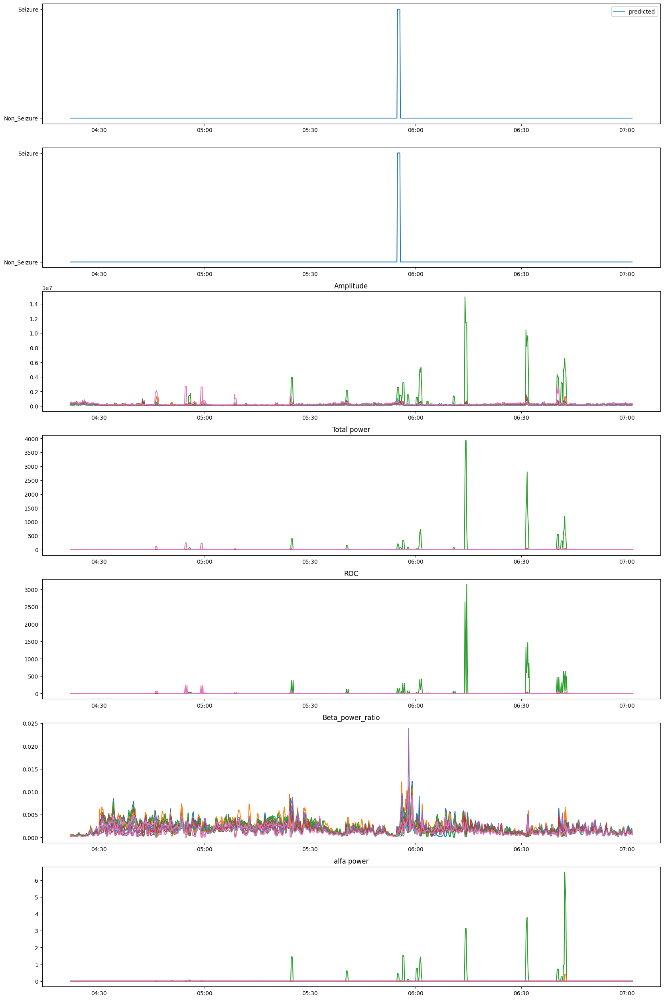

Patient04-5


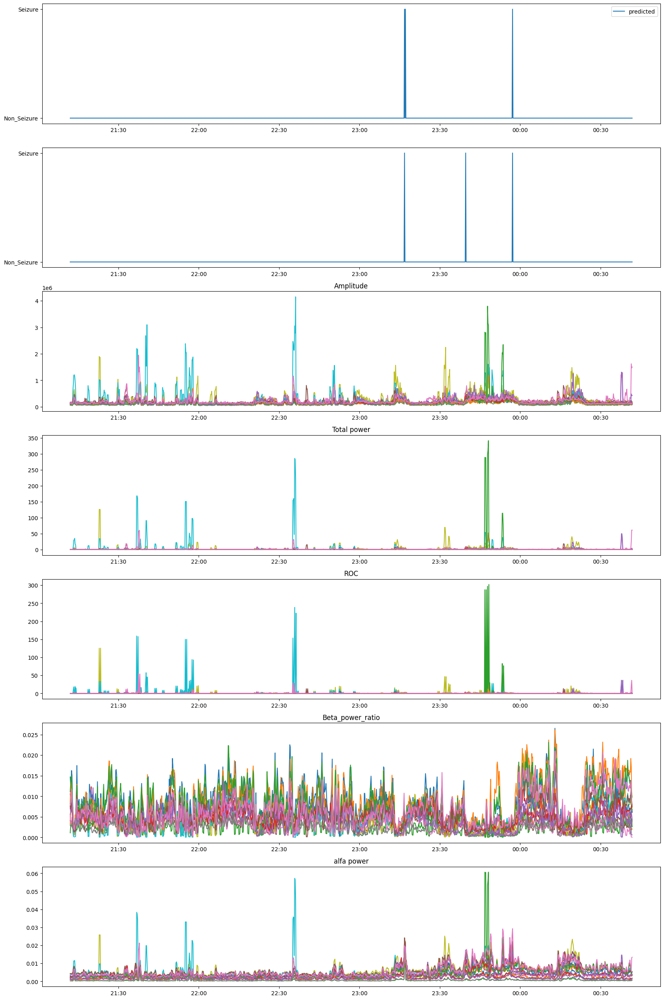

Patient04-1


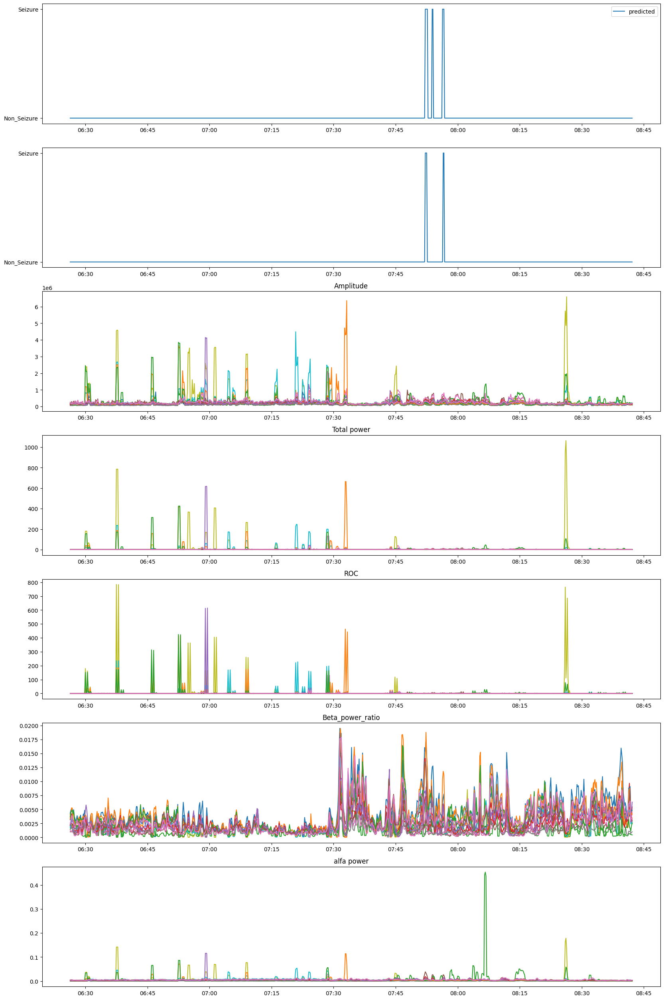

Patient04-2


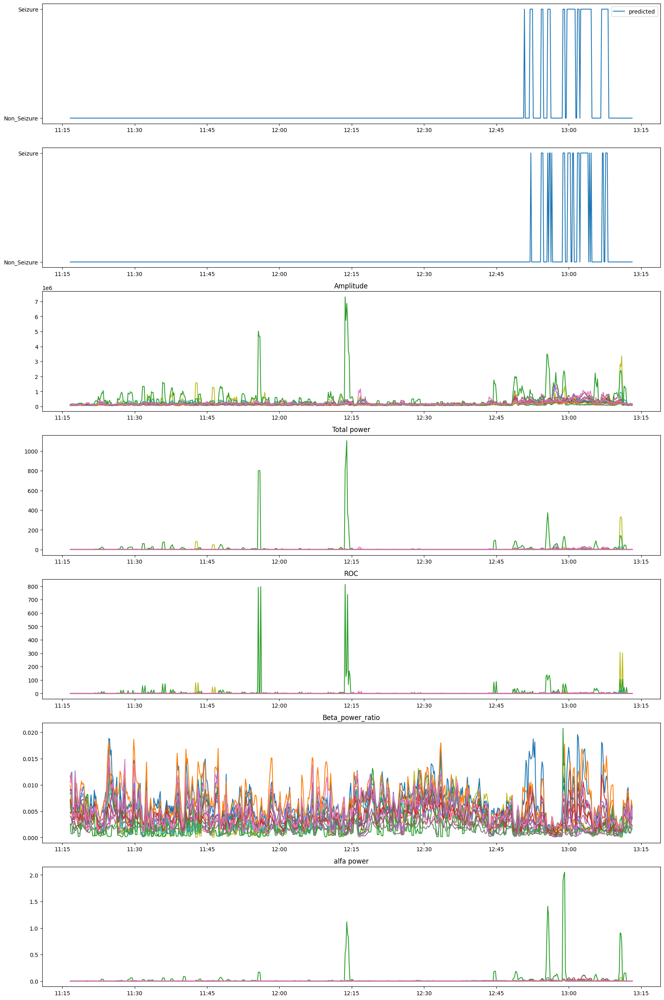

Patient04-3


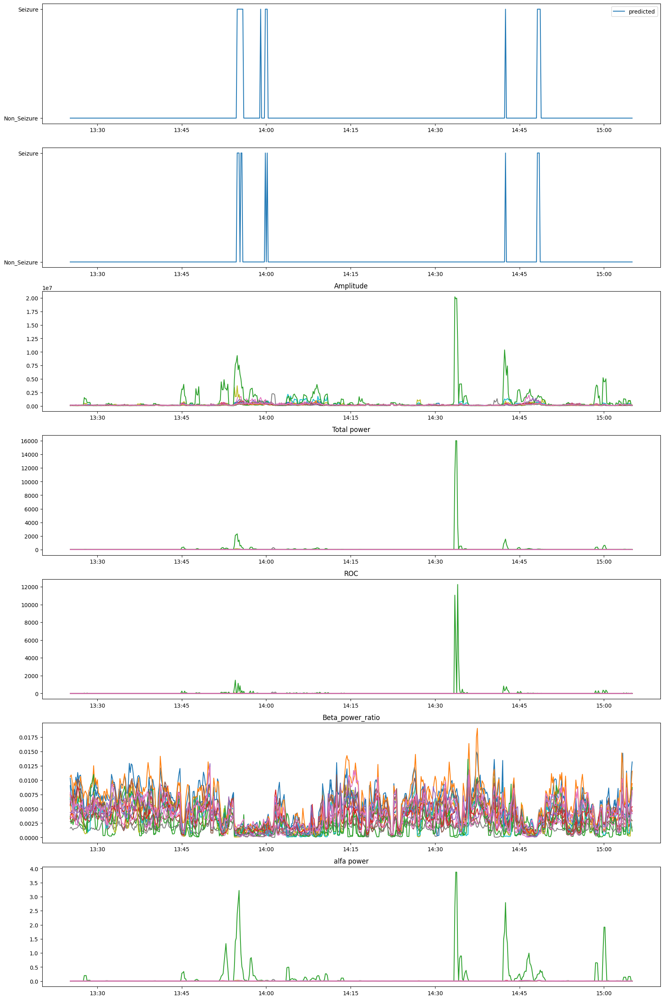

Patient10-3


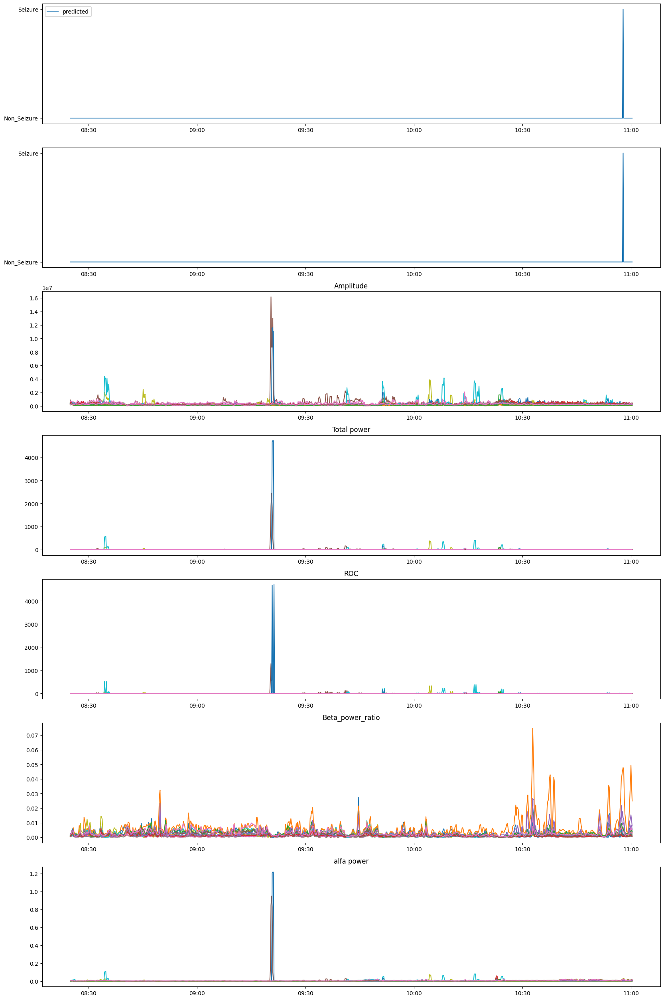

Patient10-1


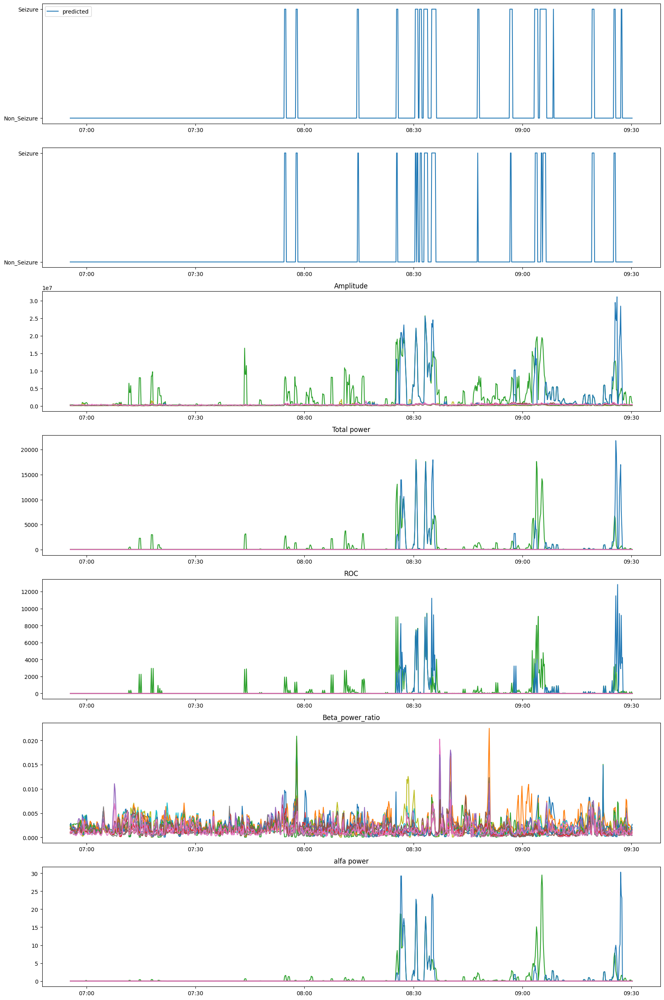

Patient10-2


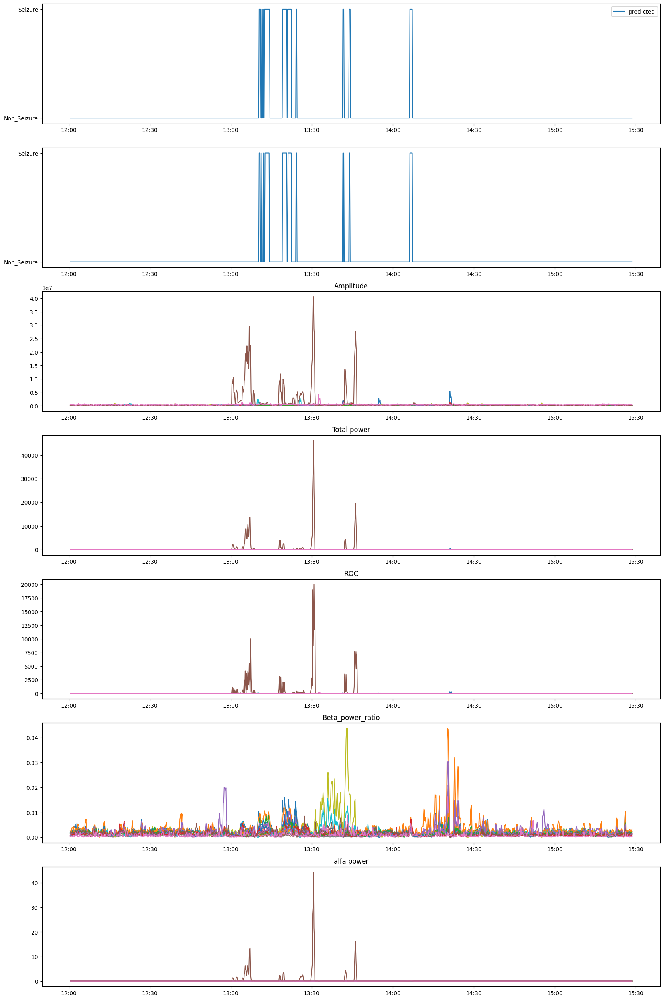

Patient12-2


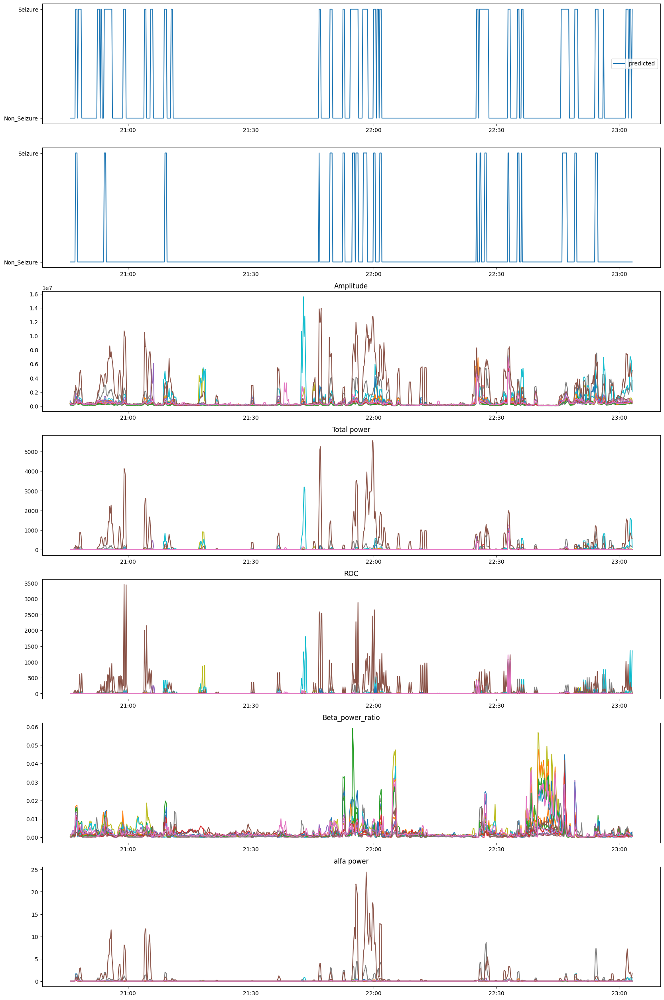

Patient12-1


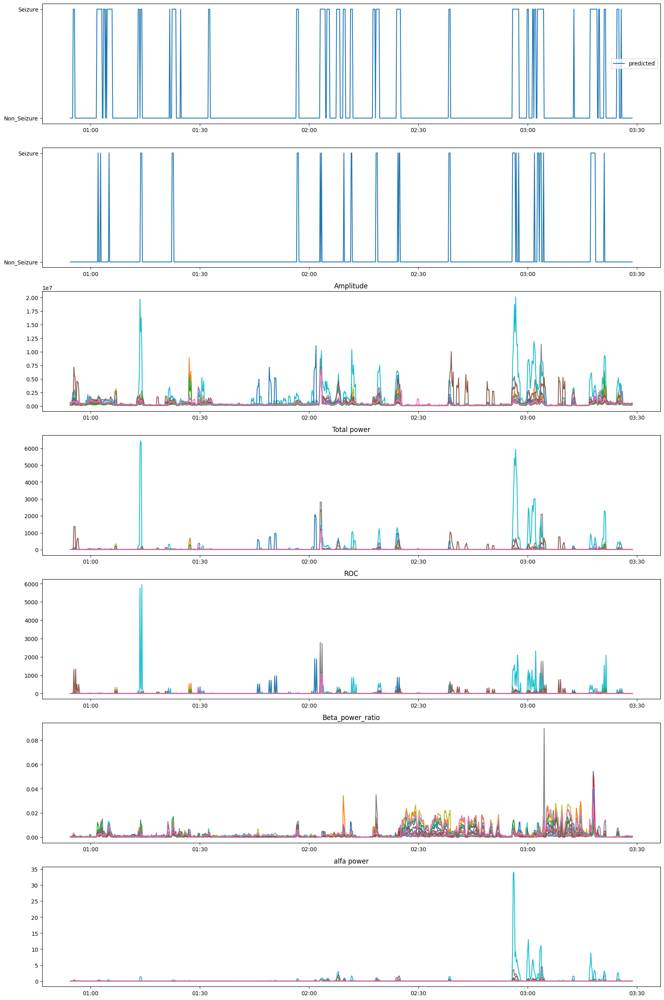

Patient09-2


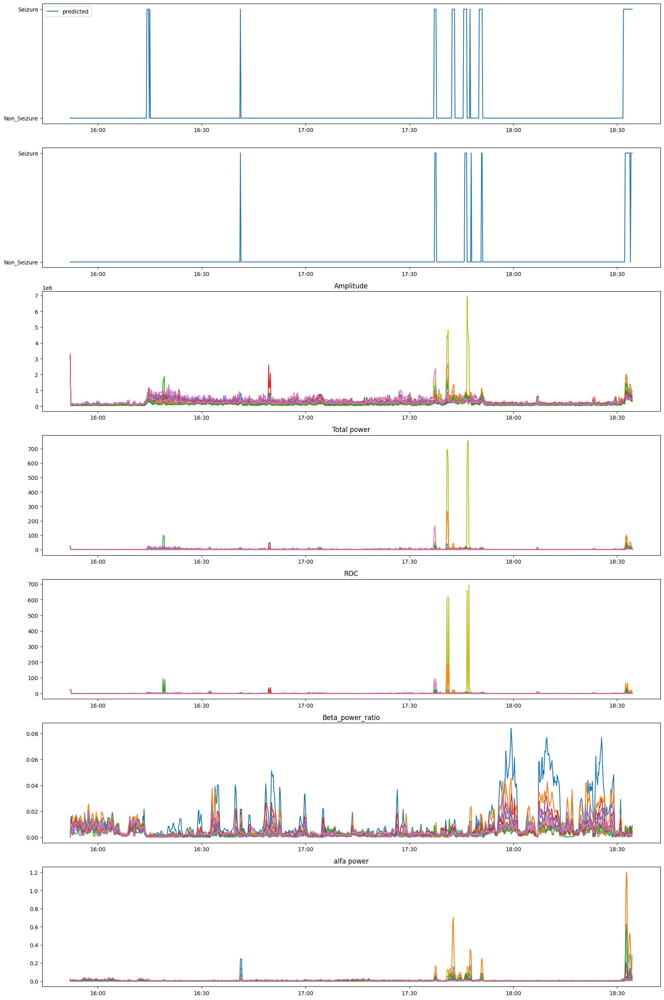

Patient09-3


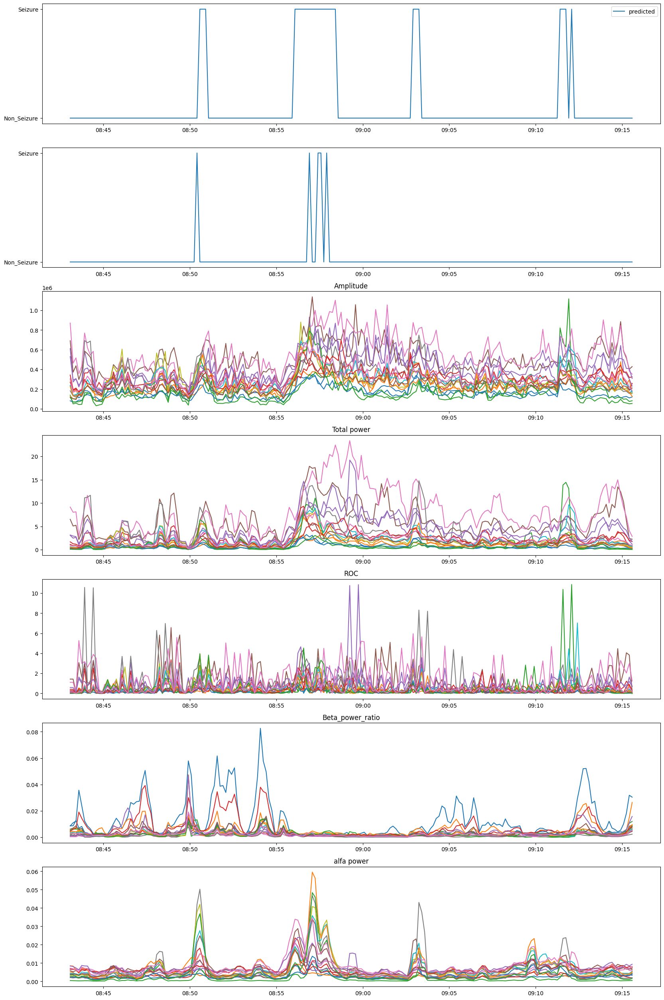

Patient09-1


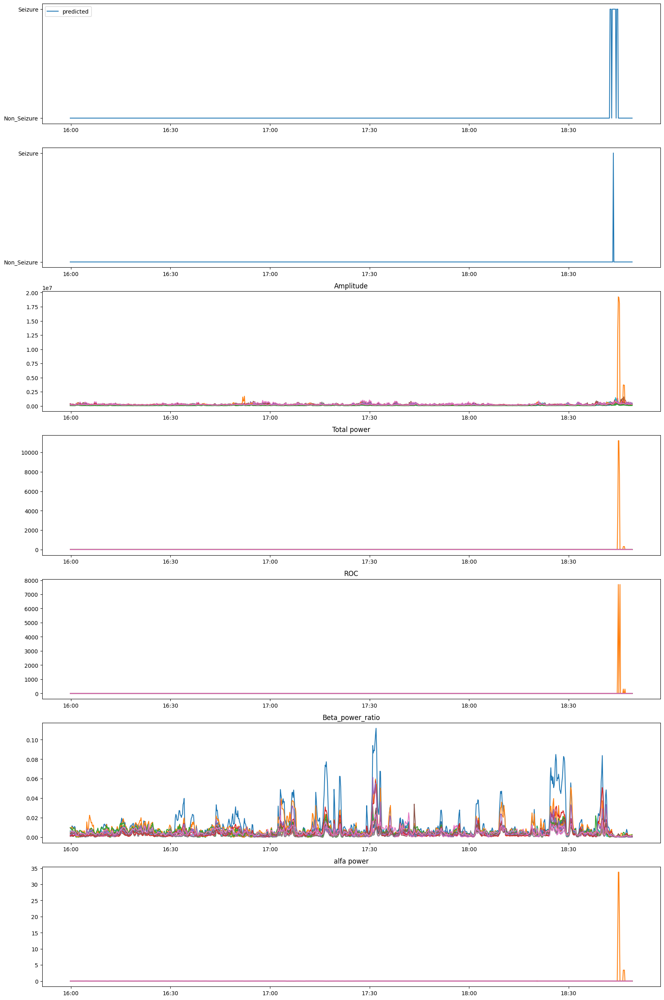

Patient11-1


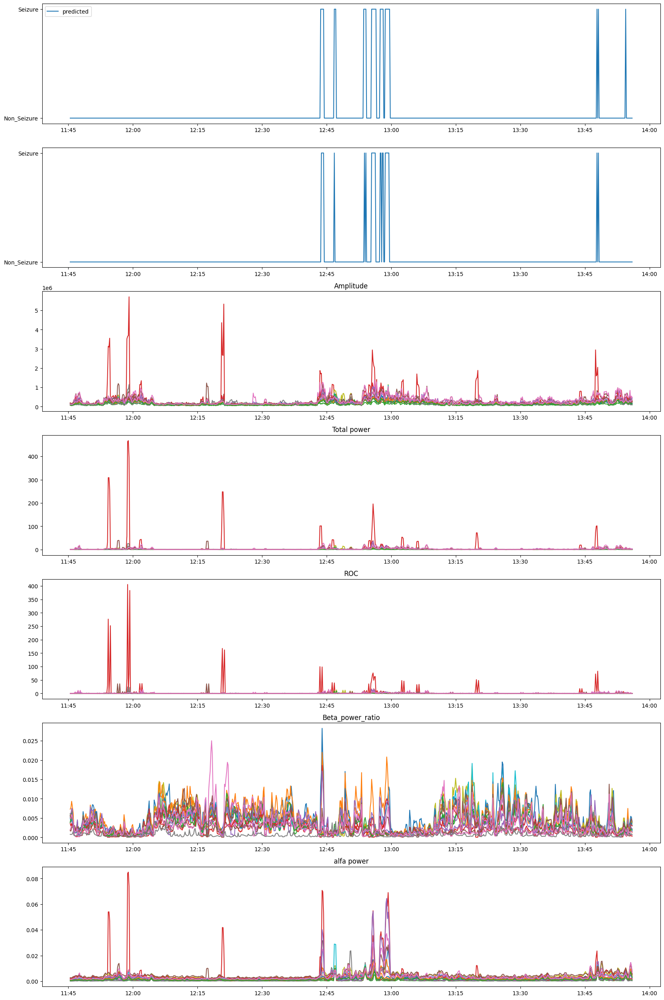

Patient11-2


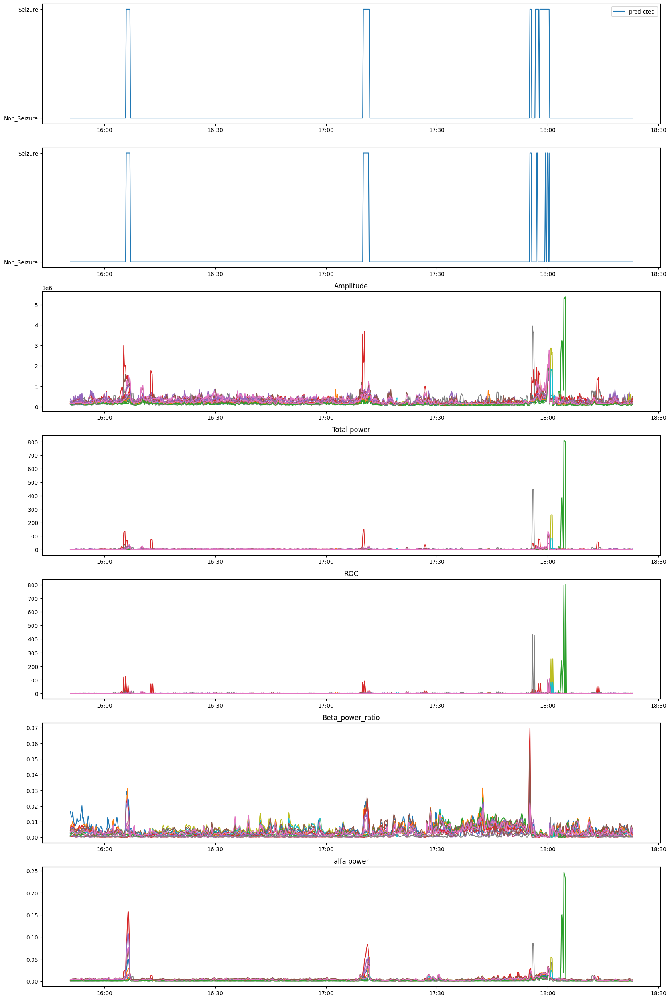

Patient11-3


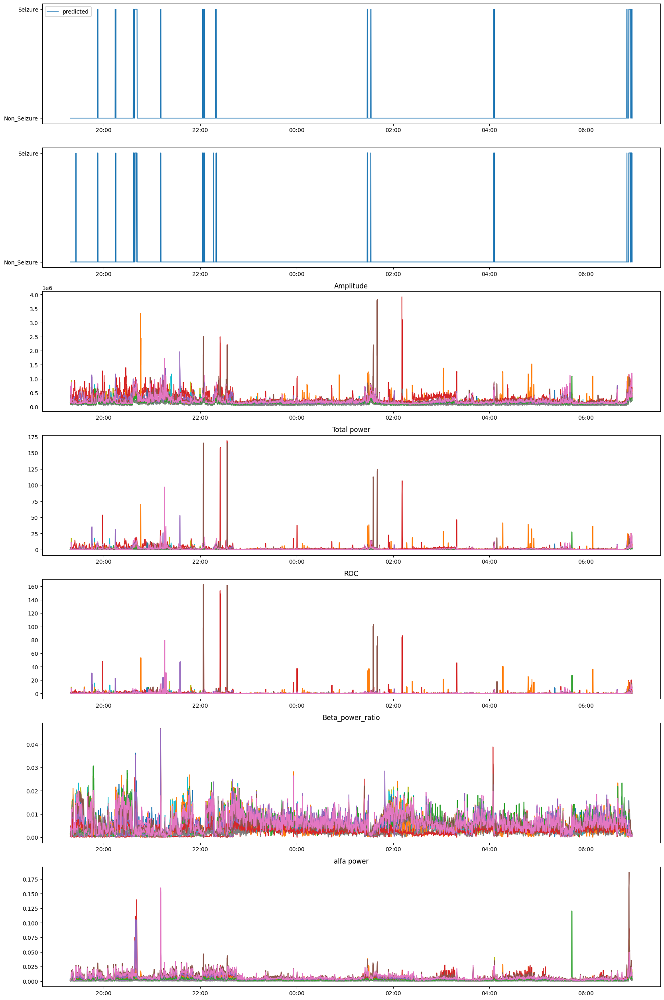

Patient11-4


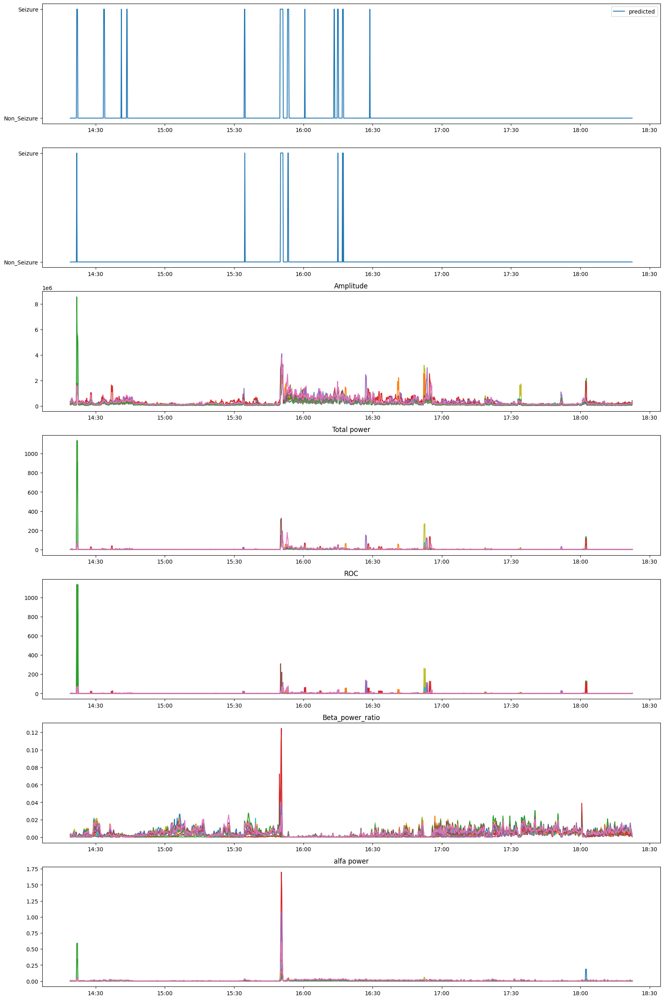

Patient07-1


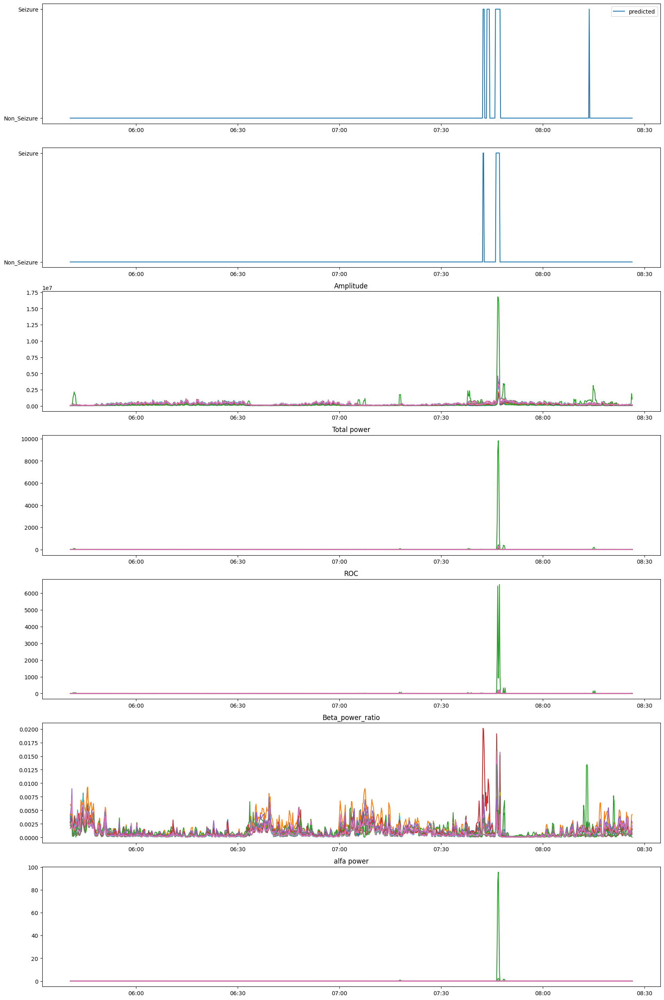

Patient07-2


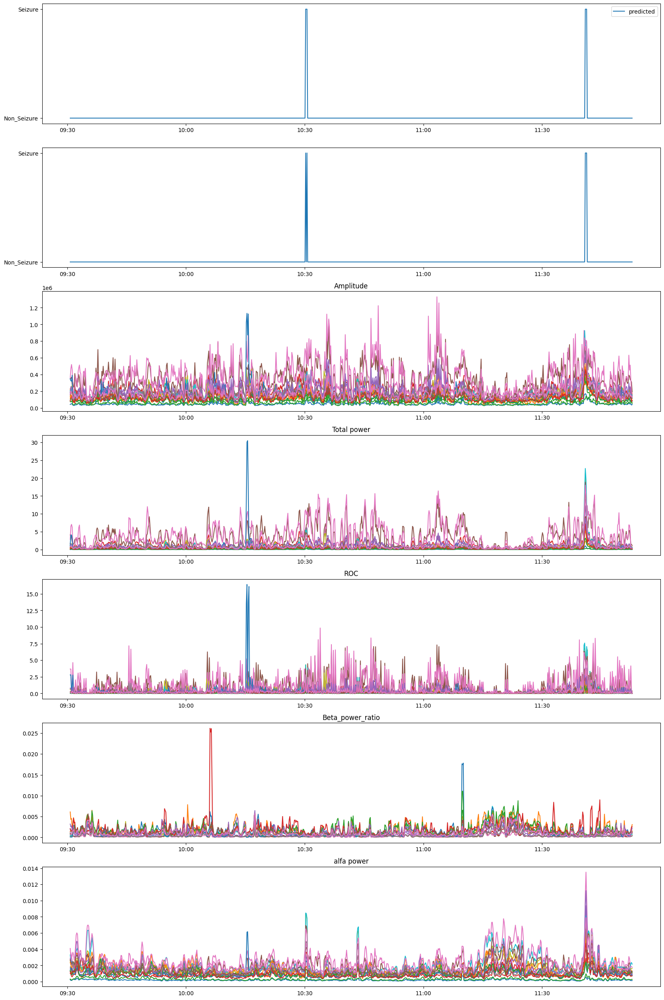

Patient07-3


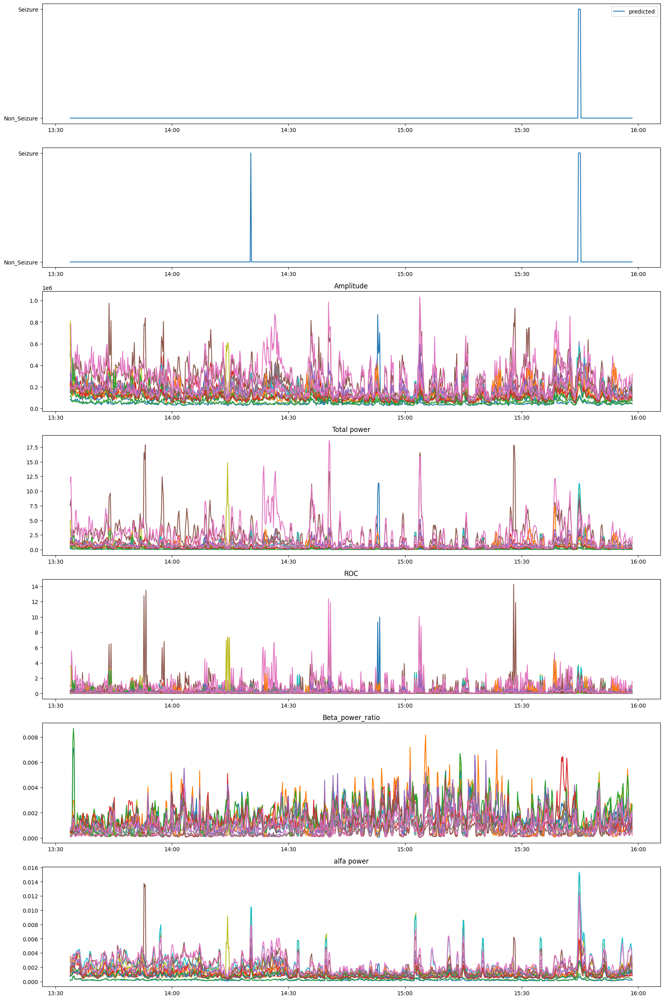

Patient07-4


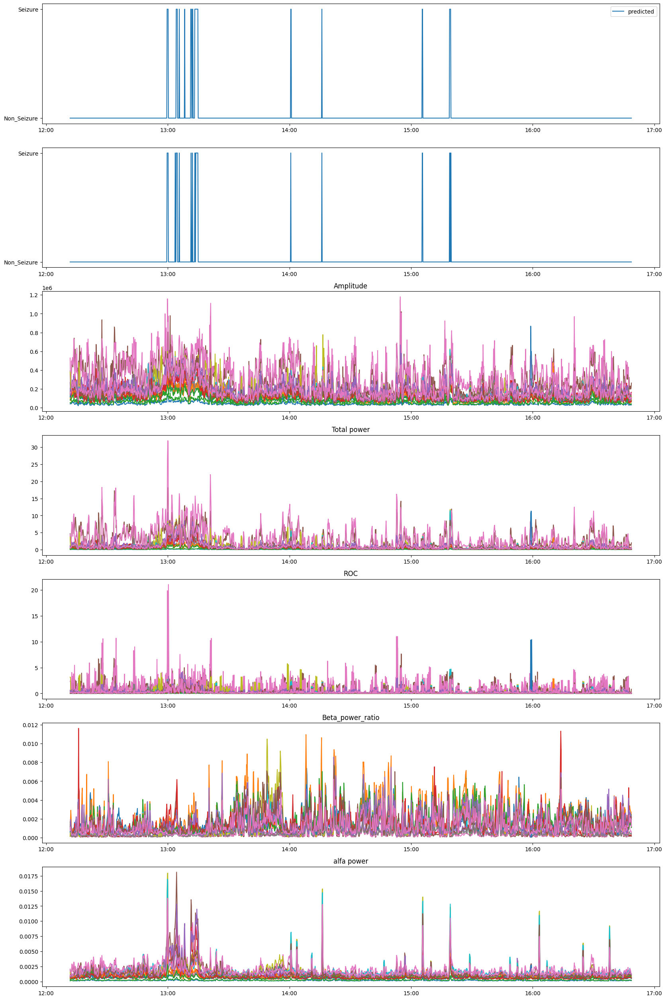

Patient07-5


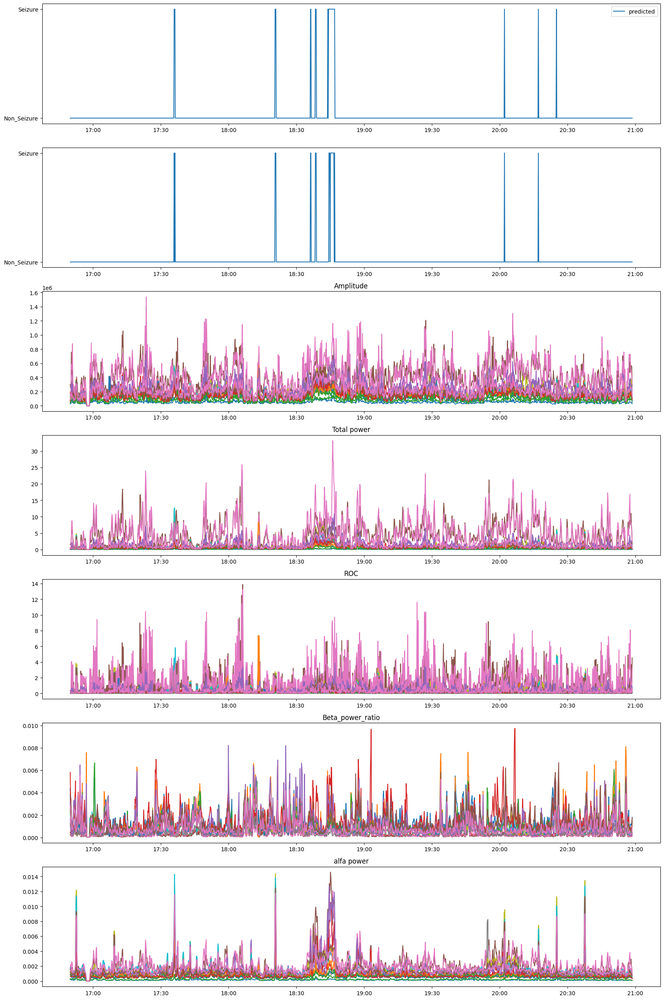

Patient07-6


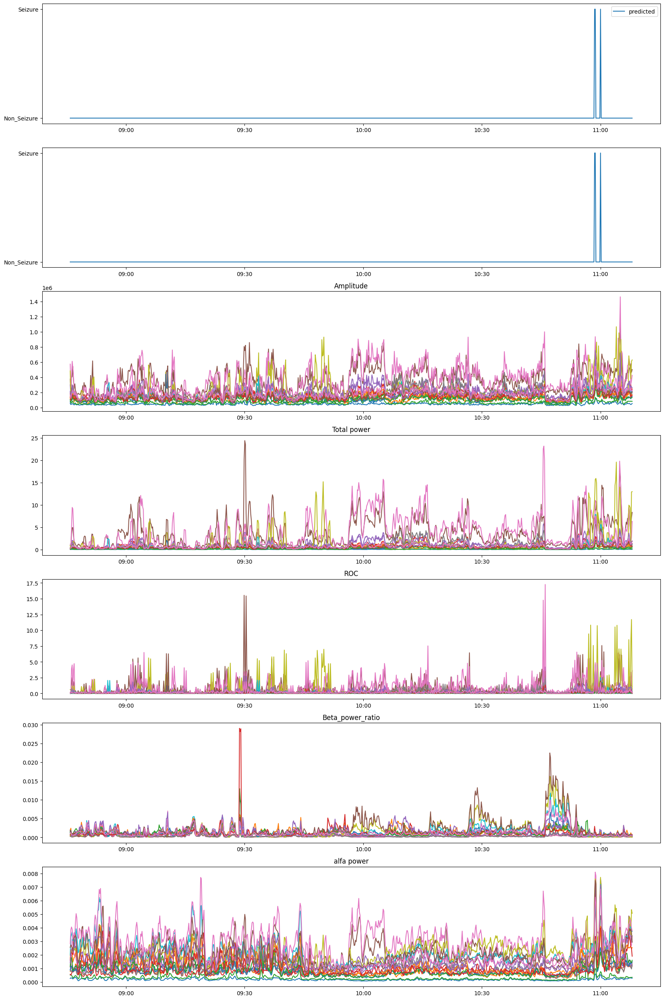

Patient13-2


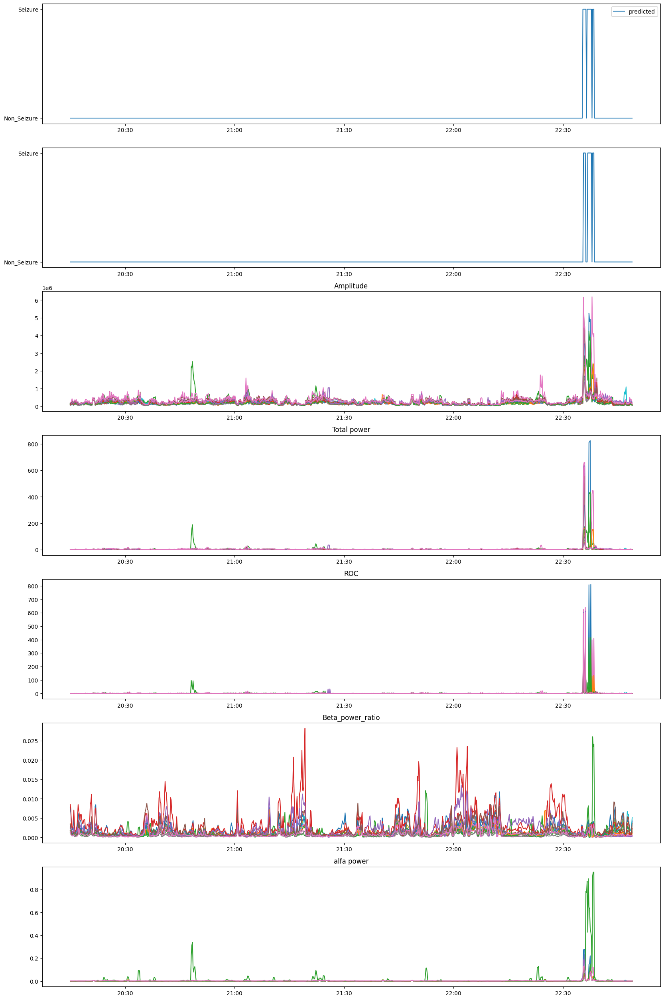

Patient13-1


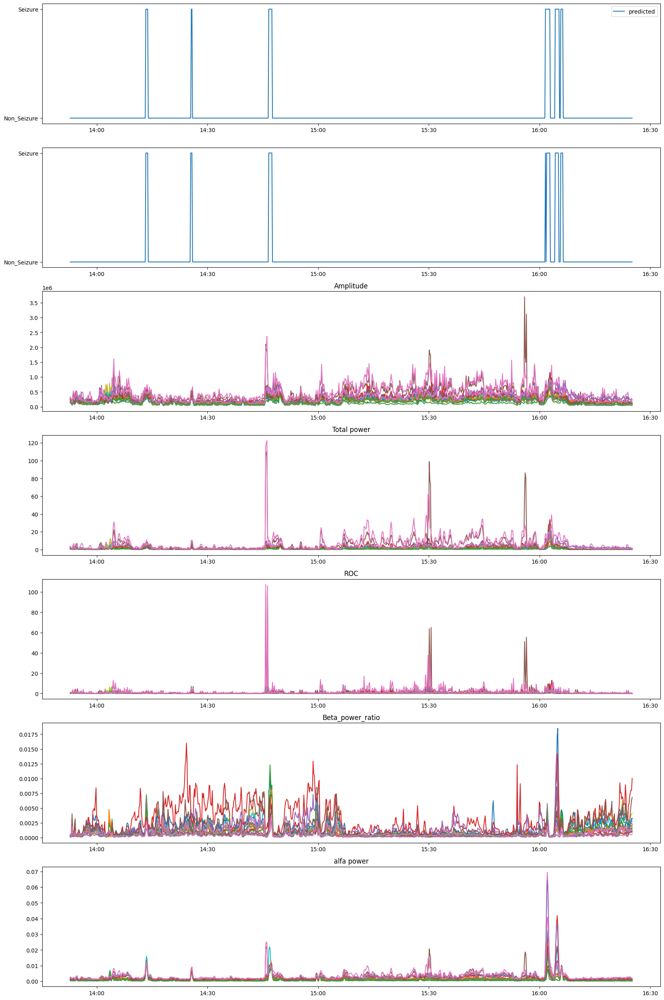

Patient05-1


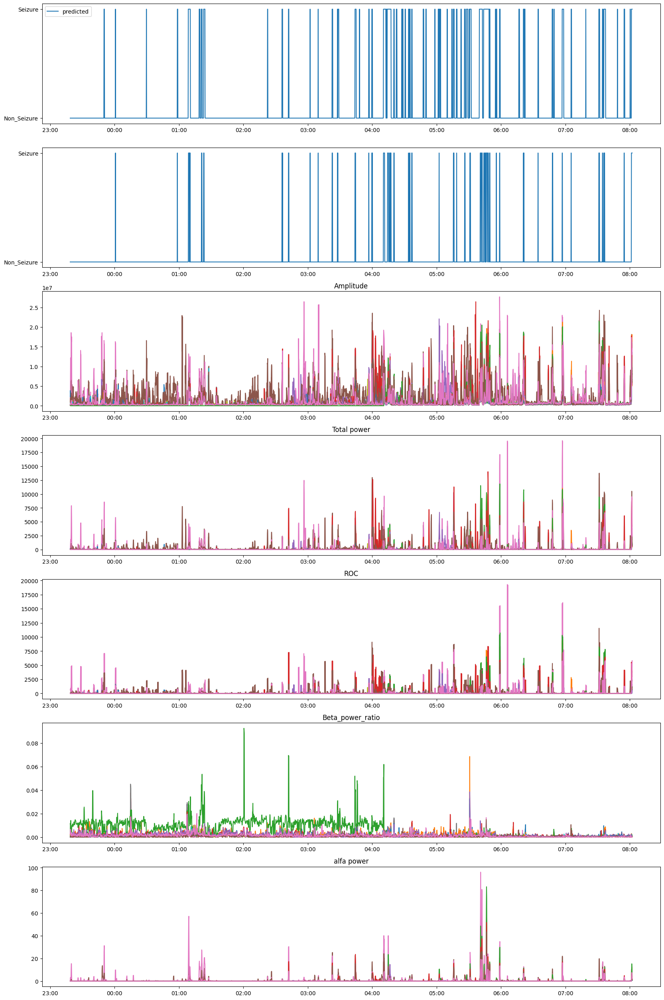

Patient06-2


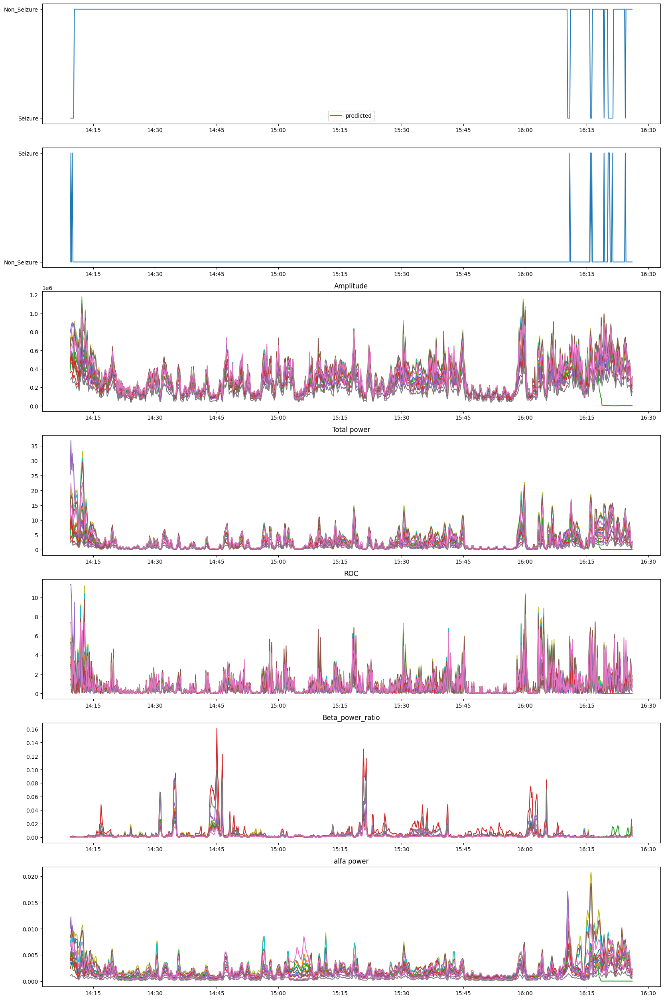

Patient06-3


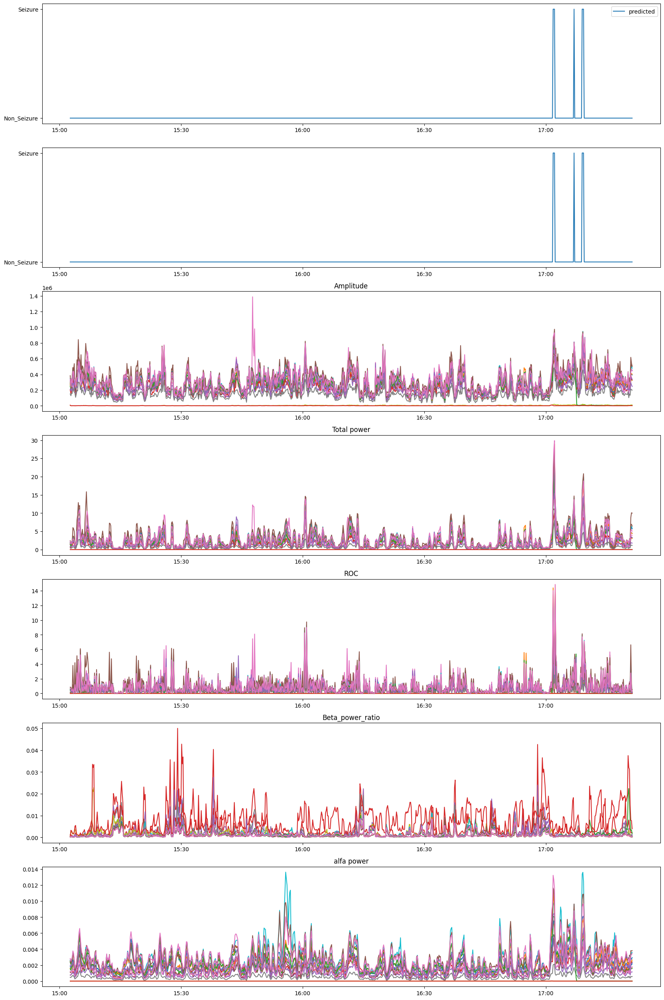

Patient06-1


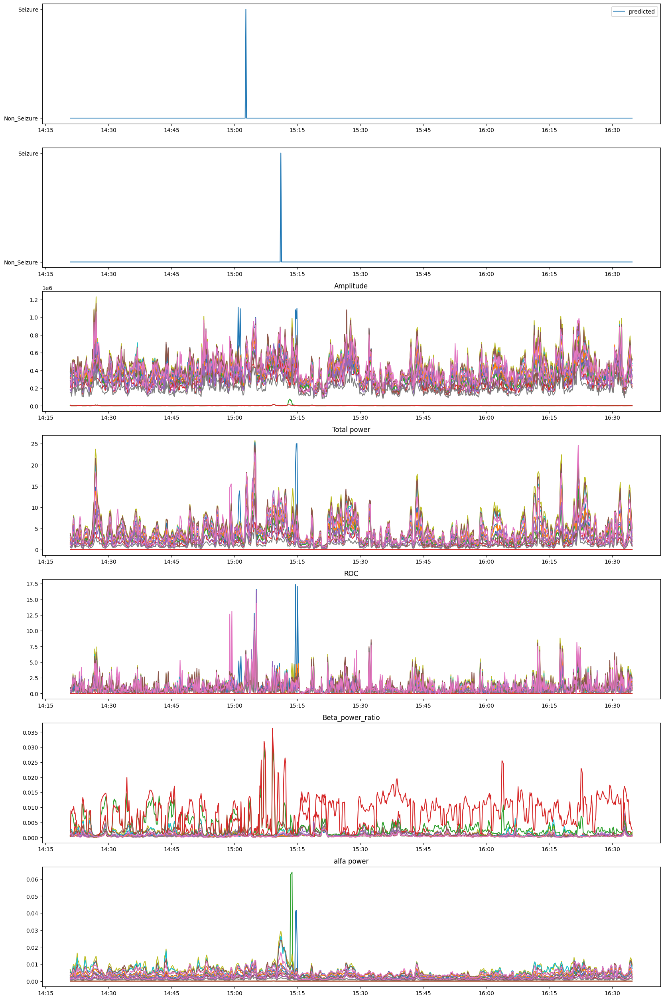

Patient08-1


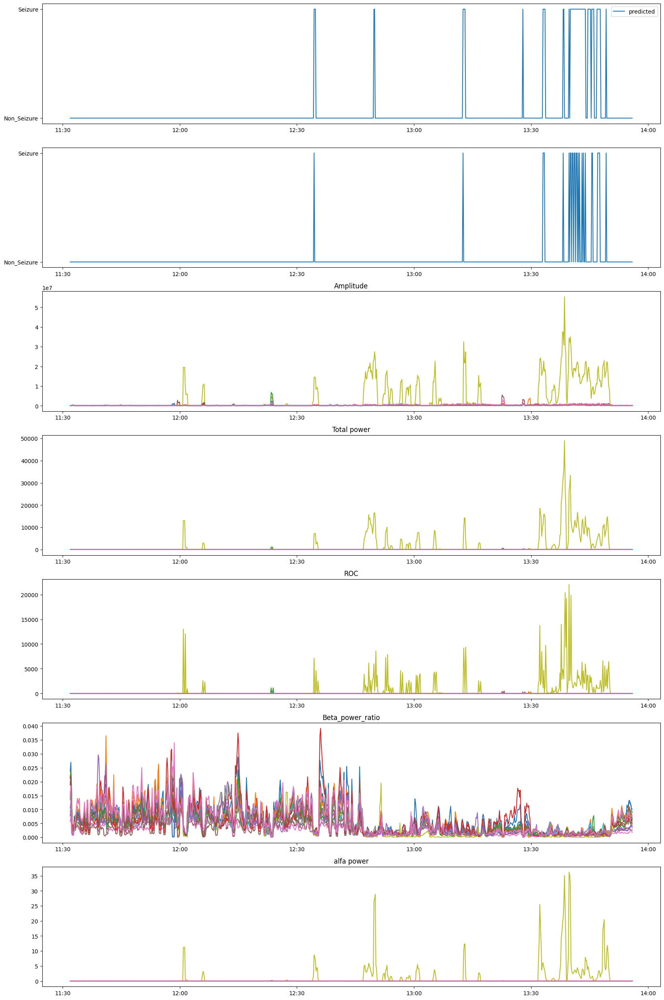

Patient01-1


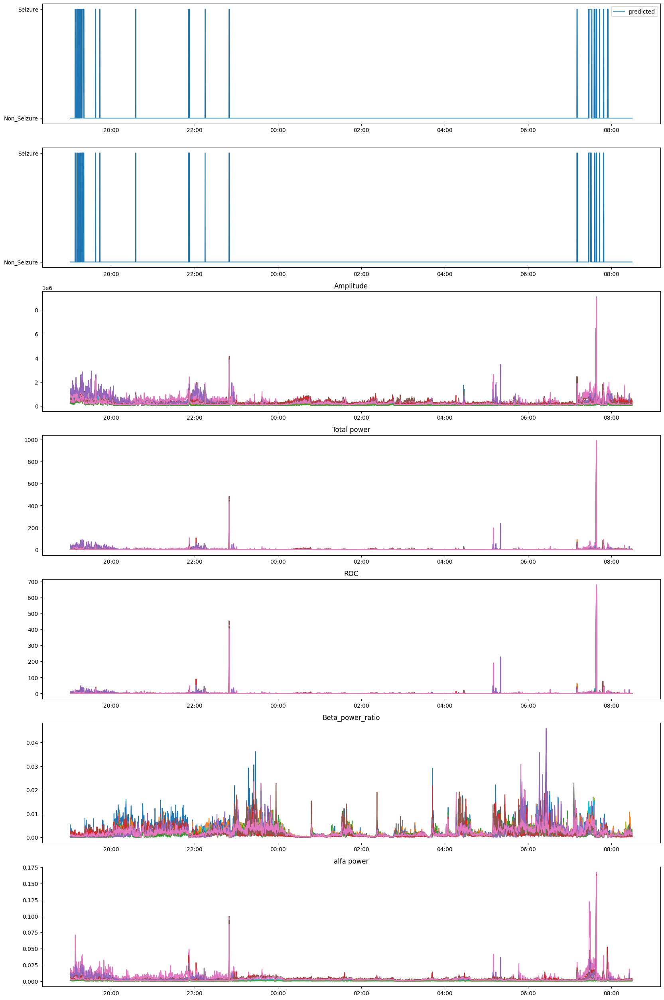

Patient02-2


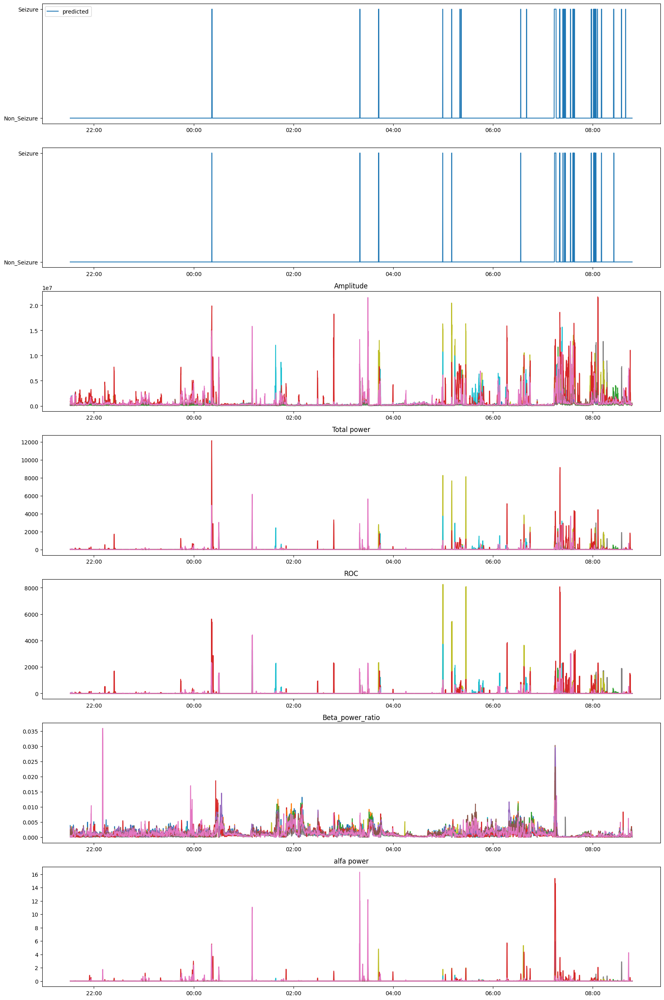

Patient02-1


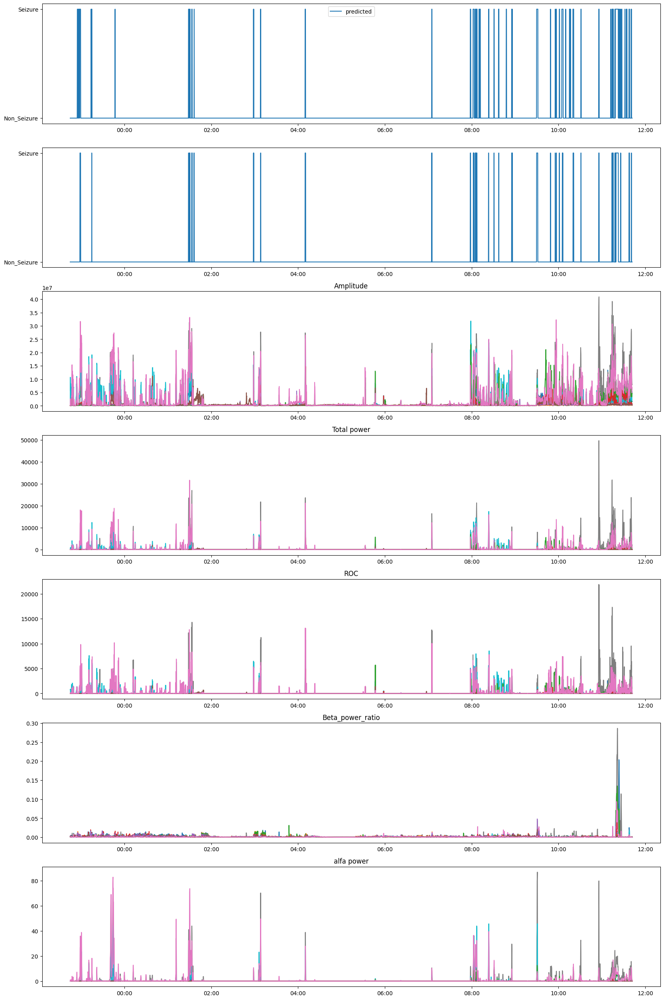

Patient00-2


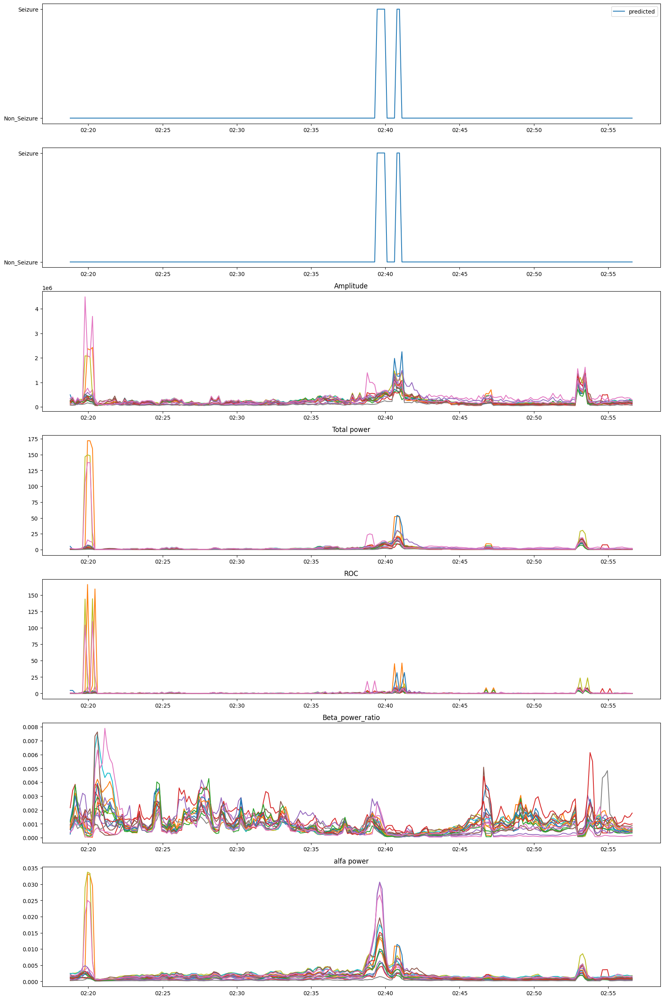

Patient00-1


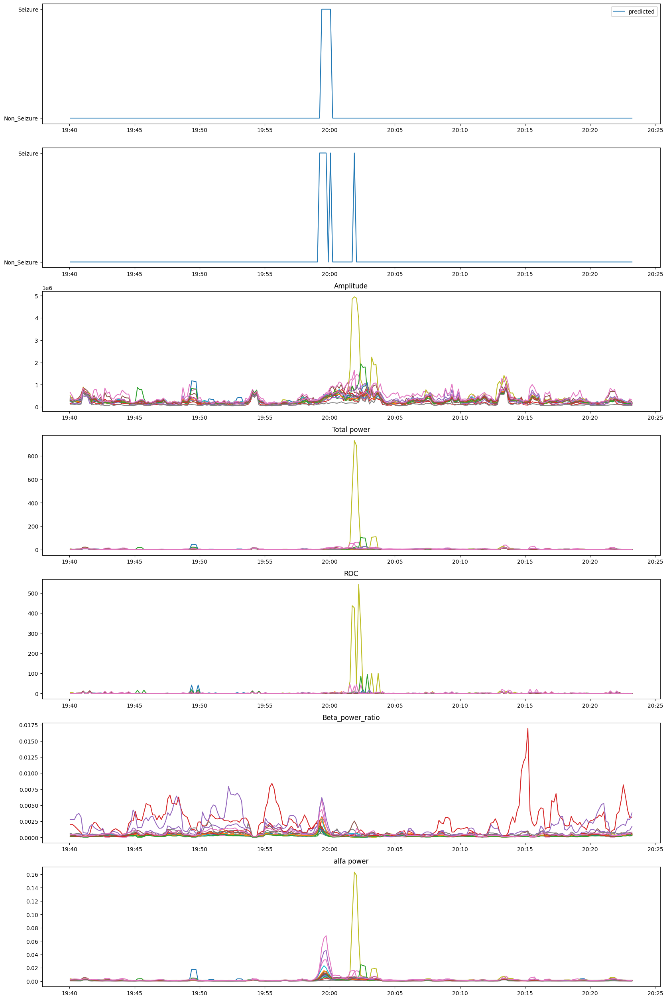

Patient00-3


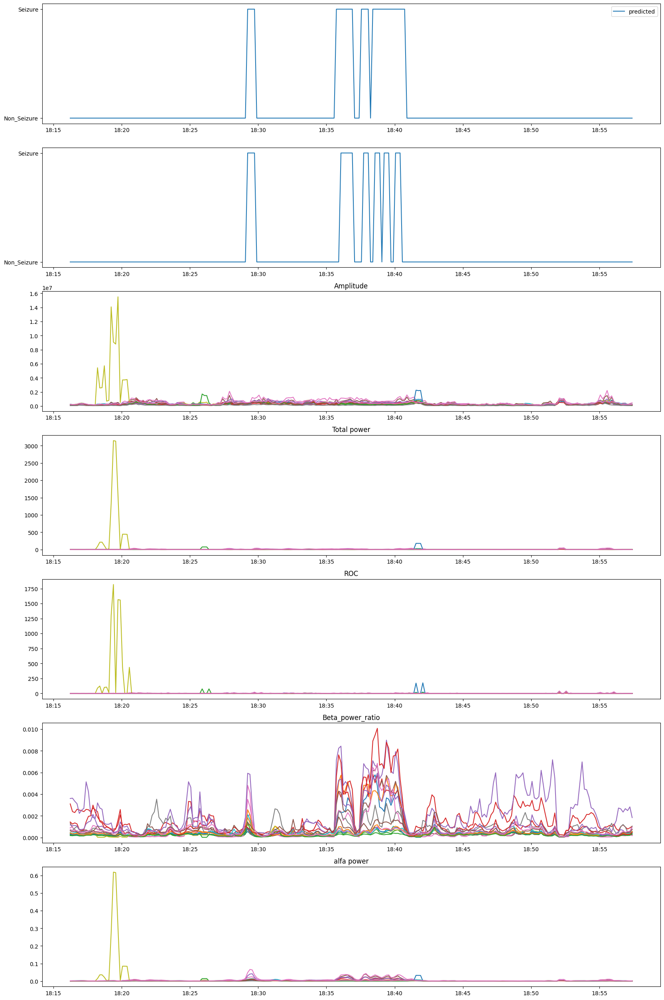

Patient00-4


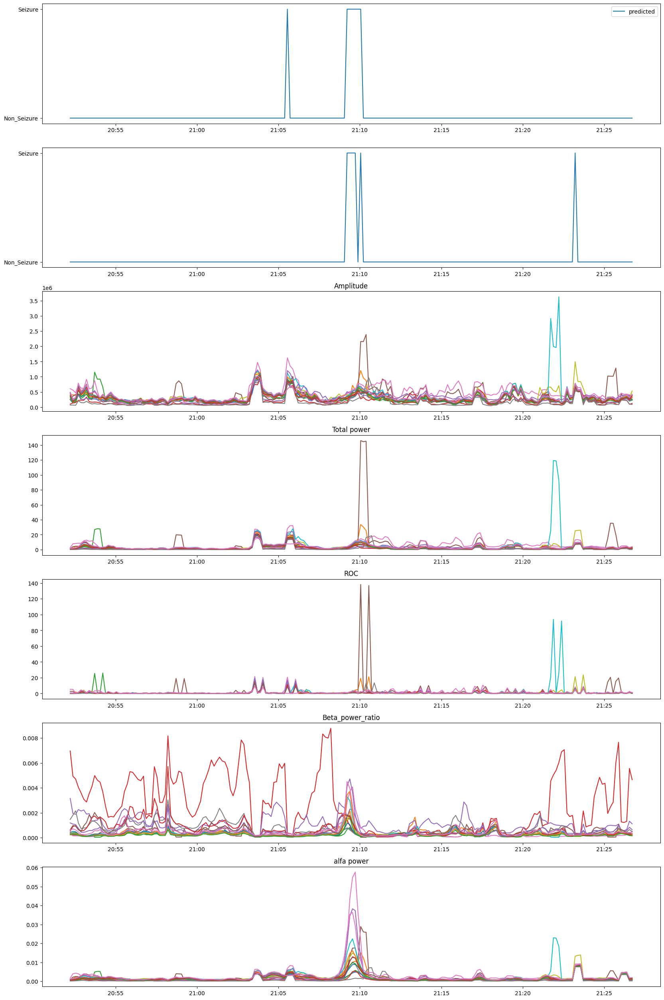

Patient00-5


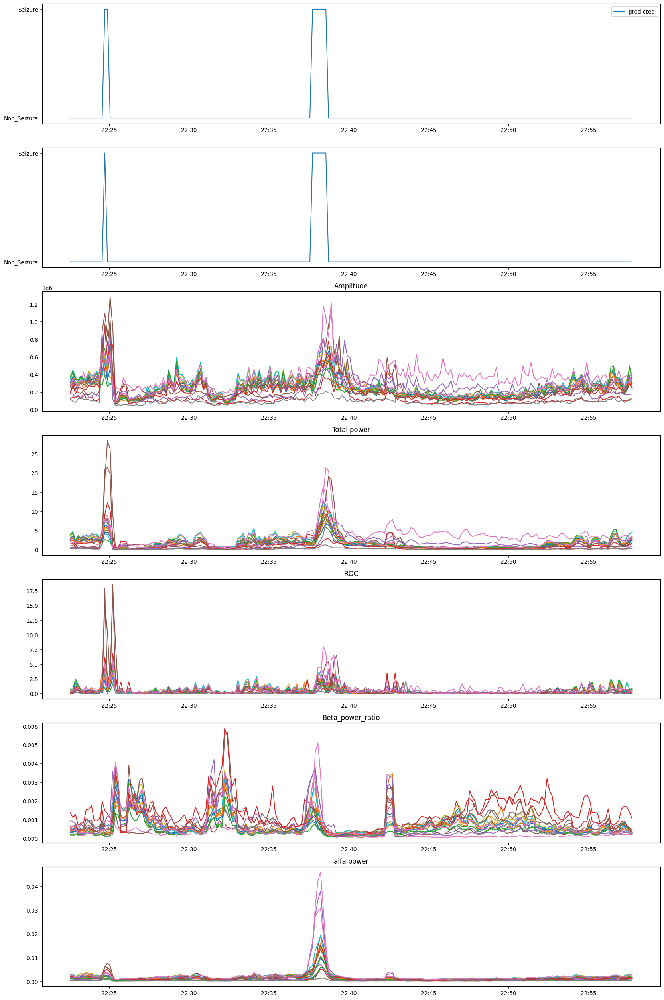

Patient03-1


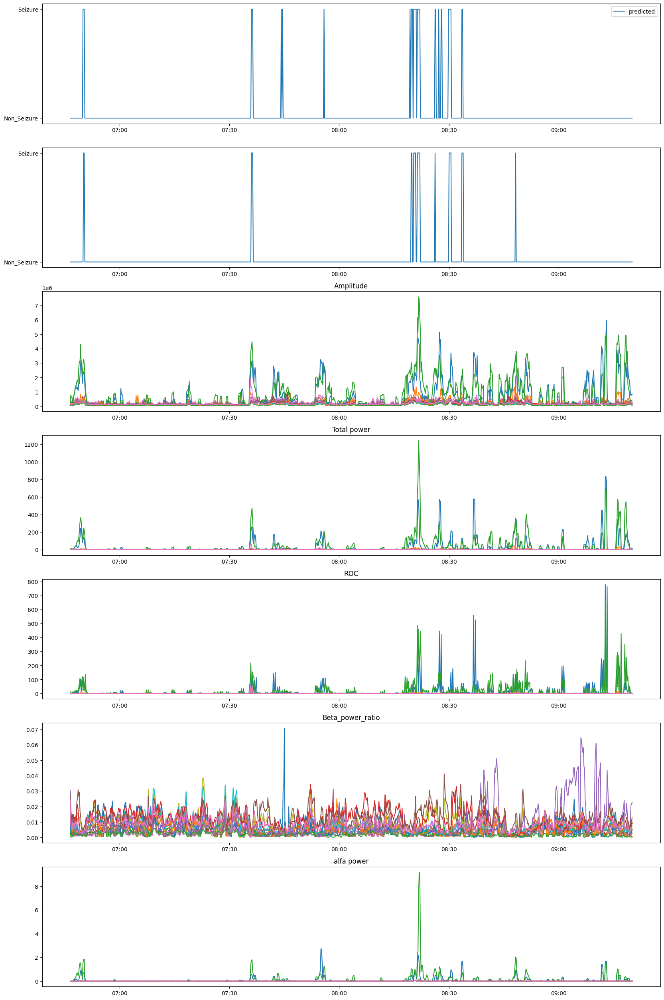

Patient03-2


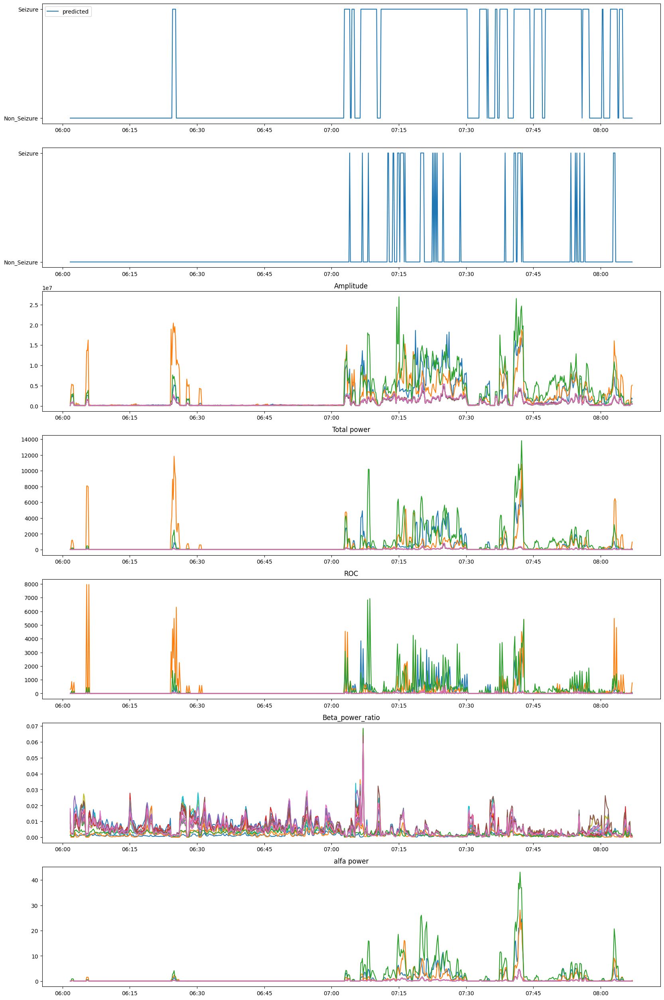

Patient03-3


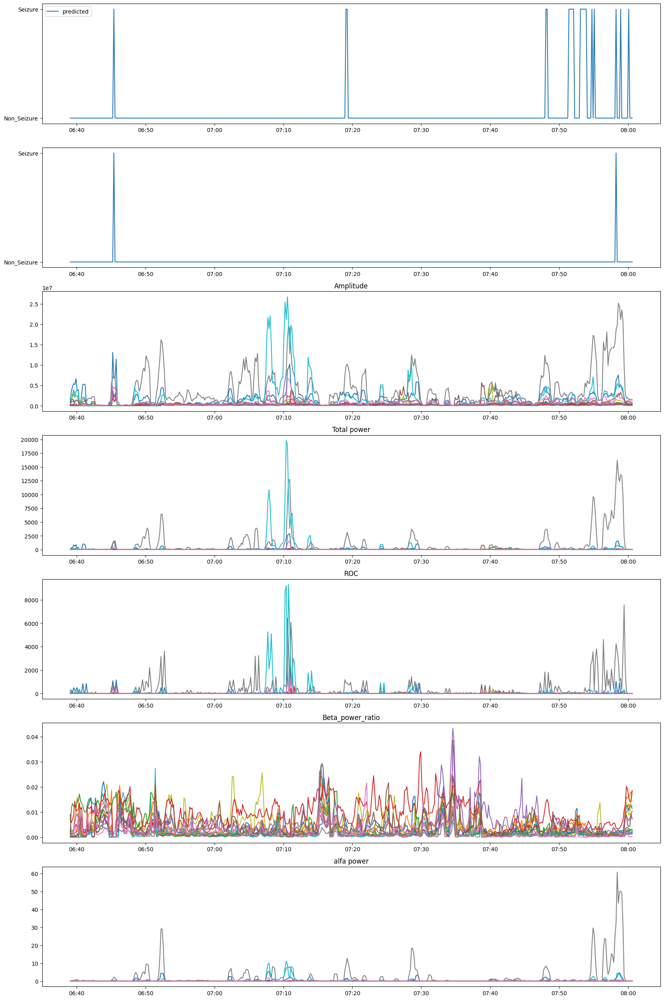

In [ ]:
Predicted_df =pd.DataFrame() # Prediction dataframe
for subs in labeled_data_train['Subject'].unique(): # iterating over each unique subject
    sub_test =  labeled_data_train.groupby('Subject').get_group(subs) #getting sub group data
    prd = sub_test.loc[:, ~sub_test.columns.isin(['Assigned_label','Subject','Time'])] # selecting only feature columns
    prd.columns = col_ren # Assigning encoded feature names
    prd = prd.astype('float') 
    
    print(subs)

    y_p = vt.predict(prd) #predicting over subject data
    sub_test['Predicted_label'] = y_p # Assigning it to predicted label
    
    # Plotting rule features and labels

    fig, ax = plt.subplots(7,1, figsize = (20,32))
    # plotting predicted label
    ax[0].plot(sub_test['Time'],y_p, label = 'predicted')
    ax[0].set_yticks(['Non_Seizure','Seizure'])
    ax[0].xaxis.set_major_formatter(xformatter)
    ax[0].legend()
    
    # plotting assigned label
    ax[1].plot(sub_test['Time'],sub_test['Assigned_label'].values, label = 'Assigned')
    ax[1].set_yticks(['Non_Seizure','Seizure'])
    ax[1].xaxis.set_major_formatter(xformatter)

    # plotting amplitude
    ax[2].plot(sub_test['Time'],sub_test[channel_list_75])
    
    ax[2].xaxis.set_major_formatter(xformatter)
    ax[2].set_title('Amplitude')

    # plotting powerl
    ax[3].plot(sub_test['Time'],sub_test[channel_list_powr])
    
    ax[3].xaxis.set_major_formatter(xformatter)
    ax[3].set_title('Total power')

    # plotting ROC
    ax[4].plot(sub_test['Time'],sub_test[channel_list_ROC])
    
    ax[4].xaxis.set_major_formatter(xformatter)
    ax[4].set_title('ROC')

    #plotting beta power ratio
    ax[5].plot(sub_test['Time'],sub_test[channel_list_betpowr_r])
    
    ax[5].xaxis.set_major_formatter(xformatter)
    ax[5].set_title('Beta_power_ratio')

    # plotting alfapower 
    ax[6].plot(sub_test['Time'],sub_test[channle_list_alfapowr])
    
    ax[6].xaxis.set_major_formatter(xformatter)
    ax[6].set_title('alfa power')


    plt.show()
    Predicted_df = pd.concat([Predicted_df, sub_test])

In [ ]:
Predicted_df[["Time", 'Predicted_label']]

,Time,Predicted_label
0,2016-01-01 04:21:51.998046875+00:00,Non_Seizure
1,2016-01-01 04:22:01.998046875+00:00,Non_Seizure
2,2016-01-01 04:22:11.998046875+00:00,Non_Seizure
3,2016-01-01 04:22:21.998046875+00:00,Non_Seizure
4,2016-01-01 04:22:31.998046875+00:00,Non_Seizure
...,...,...
50662,2016-01-01 07:59:54.998046875+00:00,Non_Seizure
50663,2016-01-01 08:00:04.998046875+00:00,Seizure
50664,2016-01-01 08:00:14.998046875+00:00,Non_Seizure
50665,2016-01-01 08:00:24.998046875+00:00,Non_Seizure


In [ ]:
Predicted_df['Subject']

0        Patient04-4
1        Patient04-4
2        Patient04-4
3        Patient04-4
4        Patient04-4
            ...     
50662    Patient03-3
50663    Patient03-3
50664    Patient03-3
50665    Patient03-3
50666    Patient03-3
Name: Subject, Length: 50667, dtype: object

 Extracting continuous seizure instants as we did for random forest before

In [ ]:
excel_df = pd.DataFrame()

for id in sub_ids:
    df_test = df_grp.get_group(id)
    df_test.reset_index(drop = True, inplace = True)
    print(id)
    
    # print(df_test.head(1))
    indx1= df_test[df_test['Predicted_label']=='Seizure'].index
    df_sub1 = pd.DataFrame()
    if len(indx1)>0:
        inda = (np.diff(indx1)>1).nonzero()
        print('len of ind', len(inda))
        
        # if len(inda)>0:
        ind2 =np.asarray(inda)+1
        print(ind2)
        
    
        for arr in np.split(indx1,ind2.flatten()):
            print(arr)
            # prtin(arr)
        
            dict1={}
            # print(df_test['Time'].dt.time.loc[arr[0]:arr[-1]])
            dict1['Patient_Subfile'] = id
            dict1['t_start'] = df_test['Time'].dt.time.loc[arr[0]]
            dict1['t_end'] = df_test['Time'].dt.time.loc[arr[-1]]
            dict1['index_start'] = arr[0]
            dict1['index_end'] = arr[-1]

            df_sub1 = df_sub1.append(dict1, ignore_index = True)
            # print(dict1)
    else:
        print('condition not satisfied')
        dict1={}
        # print(df_test['Time'].dt.time.loc[arr[0]:arr[-1]])
        dict1['Patient_Subfile'] = id
        dict1['t_start'] = 'Not availabel'
        dict1['t_end'] = 'Not available'
        dict1['index_start'] = 'Not available'
        dict1['index_end'] = 'Not available'
        df_sub1 = df_sub1.append(dict1, ignore_index = True)



    excel_df = pd.concat([excel_df,df_sub1])
       



Patient04-4
len of ind 1
[]
Int64Index([558, 559, 560, 561, 562, 563], dtype='int64')
Patient04-5
len of ind 1
[[1 2]]
Int64Index([749], dtype='int64')
Int64Index([751], dtype='int64')
Int64Index([991], dtype='int64')
Patient04-1
len of ind 1
[[4 7]]
Int64Index([515, 516, 517, 518], dtype='int64')
Int64Index([525, 526, 527], dtype='int64')
Int64Index([540, 541, 542], dtype='int64')
Patient04-2
len of ind 1
[[ 1  5  8 12 15 26 29 43]]
Int64Index([565], dtype='int64')
Int64Index([572, 573, 574, 575], dtype='int64')
Int64Index([586, 587, 588], dtype='int64')
Int64Index([594, 595, 596, 597], dtype='int64')
Int64Index([613, 614, 615], dtype='int64')
Int64Index([618, 619, 620, 621, 622, 623, 624, 625, 626, 627, 628], dtype='int64')
Int64Index([631, 632, 633], dtype='int64')
Int64Index([635, 636, 637, 638, 639, 640, 641, 642, 643, 644, 645, 646, 647,
            648],
           dtype='int64')
Int64Index([661, 662, 663, 664, 665, 666, 667, 668, 669], dtype='int64')
Patient04-3
len of ind 1
[[

In [ ]:
excel_df.reset_index(drop = True, inplace = True)
excel_df

,Patient_Subfile,t_start,t_end,index_start,index_end
0,Patient04-4,05:54:51.998046,05:55:41.998046,558,563
1,Patient04-5,23:16:48.998046,23:16:48.998046,749,749
2,Patient04-5,23:17:08.998046,23:17:08.998046,751,751
3,Patient04-5,23:57:08.998046,23:57:08.998046,991,991
4,Patient04-1,07:52:10.998046,07:52:40.998046,515,518
5,Patient04-1,07:53:50.998046,07:54:10.998046,525,527
6,Patient04-1,07:56:20.998046,07:56:40.998046,540,542
7,Patient04-2,12:50:48.998046,12:50:48.998046,565,565
8,Patient04-2,12:51:58.998046,12:52:28.998046,572,575
9,Patient04-2,12:54:18.998046,12:54:38.998046,586,588


In [ ]:
# excel_df = pd.read_csv('/content/drive/MyDrive/Patient_data_predicted_labels/excel_df.csv')

Windowing for seizure instants ( window length =approximately 15 mins or 90 smaples)

In [ ]:
excel_df_sub = pd.DataFrame()
for pat in excel_df['Patient_Subfile'].unique():	
    df_new = excel_df[excel_df['Patient_Subfile']==pat]
    df_new.reset_index(drop= True, inplace= True)
    print('This is for subject ',pat)
    print(len(df_new))
    # print(df_new)
    df_subex = pd.DataFrame()
    if len(df_new)>1: # Only considering continuous multiple seizure instants
        i=1 # initializing looping variable
        while i<len(df_new): # looping over whole length
            count=1 # initializing count to track no of continous seizure instants
            
            a = df_new[['index_start', 'index_end']].loc[i-1] # Assigning start index which is before index
            # print('its a',a)
            b = df_new[['index_start','index_end']].loc[i] # Assigning end index  for 15 min window check
            
            # print('its b', b)

            # Creating dictionary before 15 min window check
            dict1={}

            dict1['window_start']=a[0]
            dict1['window_end'] = a[-1]
            # Below both t_start and t_end are same before window check
            dict1['t_start'] = df_new['t_start'].loc[i-1]
            dict1['t_end'] = df_new['t_end'].loc[i-1]
            
            j=i # assigning to j
            
            while ((b[0]-a[-1]) <90): # Checking for 15 min or 90 samples window
                
                dict1['window_end'] = b[-1] # updating window end
                dict1['t_end'] = df_new['t_end'].loc[j] # updating  t_end
                count= count +1 #updating count
                j=j+1 # incrementing j
                if j==len(df_new): # check if the j is not over indexed
                    print('break executed end of while')
                    i=j
                    print(f'its j {j}')
                    print(dict1)
                    df_subex=df_subex.append(dict1, ignore_index= True)

                    break # break for overindexing
                # else/ not if to check for next value
                a=b # new start to last end
                b= df_new[['index_start','index_end']].loc[j] # updating b
            else: # if window size not satisfied then break and append dict
                print(dict1)
                df_subex=df_subex.append(dict1, ignore_index= True)
                print(f'its count {count}')
                print(f'its j {j}')
                if count>1: # if it was a continuous window before break then i = j next
                    print(f'its j {j}')
                    i=j+1
                else: # if its either break due to non cntionous window at all or over indexing
                    # print(dict1)
                    # print(f{})

                    if j== (len(df_new)-1): # If overindexing then loop end at last index and update dictionary
                        print(f'its j {j} in else')
                        dict1['window_start']=b[0]
                        dict1['window_end'] = b[-1]
                        dict1['t_start'] = df_new['t_start'].loc[j]
                        dict1['t_end'] = df_new['t_end'].loc[j]
                        print(dict1)
                        df_subex=df_subex.append(dict1, ignore_index= True)
                        # print(df_subex)
                        i=j+1
                    else: 
                    # If not over index but contiunous window existed before and now it has ended so dict already appended 
                        i=j+1
    else: # if it is a single value and no contionous index exist
        a = df_new[['index_start', 'index_end']].loc[0]
        # # print('its a',a)
        # b = df_new[['index_start','index_end']].loc[i]
        # # print('its b', b)
        dict1={}
        dict1['window_start']=a[0]
        dict1['window_end'] = a[-1]
        dict1['t_start'] = df_new['t_start'].loc[0]
        dict1['t_end'] = df_new['t_end'].loc[0]
        df_subex=df_subex.append(dict1, ignore_index= True)
    
    # appending final dataframe
    df_subex['Patient_Subfile']=pat
    excel_df_sub= pd.concat([excel_df_sub, df_subex])
    

    


This is for subject  Patient04-4
1
This is for subject  Patient04-5
3
{'window_start': 749, 'window_end': 751, 't_start': datetime.time(23, 16, 48, 998046), 't_end': datetime.time(23, 17, 8, 998046)}
its count 2
its j 2
its j 2
This is for subject  Patient04-1
3
break executed end of while
its j 3
{'window_start': 515, 'window_end': 542, 't_start': datetime.time(7, 52, 10, 998046), 't_end': datetime.time(7, 56, 40, 998046)}
This is for subject  Patient04-2
9
break executed end of while
its j 9
{'window_start': 565, 'window_end': 669, 't_start': datetime.time(12, 50, 48, 998046), 't_end': datetime.time(13, 8, 8, 998046)}
This is for subject  Patient04-3
4
{'window_start': 178, 'window_end': 210, 't_start': datetime.time(13, 54, 50, 998046), 't_end': datetime.time(14, 0, 10, 998046)}
its count 2
its j 2
its j 2
break executed end of while
its j 4
{'window_start': 464, 'window_end': 501, 't_start': datetime.time(14, 42, 30, 998046), 't_end': datetime.time(14, 48, 40, 998046)}
This is for 

In [ ]:
df_subex

,window_start,window_end,t_start,t_end,Patient_Subfile
0,38,38,06:45:24.998046,06:45:24.998046,Patient03-3
1,240,240,07:19:04.998046,07:19:04.998046,Patient03-3
2,434,477,07:51:24.998046,07:58:34.998046,Patient03-3


In [ ]:
excel_df_sub.reset_index(drop = True, inplace= True)
excel_df_sub

,window_start,window_end,t_start,t_end,Patient_Subfile
0,558,563,05:54:51.998046,05:55:41.998046,Patient04-4
1,749,751,23:16:48.998046,23:17:08.998046,Patient04-5
2,515,542,07:52:10.998046,07:56:40.998046,Patient04-1
3,565,669,12:50:48.998046,13:08:08.998046,Patient04-2
4,178,210,13:54:50.998046,14:00:10.998046,Patient04-3
5,464,501,14:42:30.998046,14:48:40.998046,Patient04-3
6,917,917,10:57:47.998046,10:57:47.998046,Patient10-3
7,354,375,07:54:31.998046,07:58:01.998046,Patient10-1
8,475,911,08:14:41.998046,09:27:21.998046,Patient10-1
9,420,503,13:10:30.998046,13:24:20.998046,Patient10-2


In [ ]:
excel_df

,Patient_Subfile,t_start,t_end,index_start,index_end
0,Patient04-4,05:54:51.998046,05:55:41.998046,558,563
1,Patient04-5,23:16:48.998046,23:16:48.998046,749,749
2,Patient04-5,23:17:08.998046,23:17:08.998046,751,751
3,Patient04-5,23:57:08.998046,23:57:08.998046,991,991
4,Patient04-1,07:52:10.998046,07:52:40.998046,515,518
5,Patient04-1,07:53:50.998046,07:54:10.998046,525,527
6,Patient04-1,07:56:20.998046,07:56:40.998046,540,542
7,Patient04-2,12:50:48.998046,12:50:48.998046,565,565
8,Patient04-2,12:51:58.998046,12:52:28.998046,572,575
9,Patient04-2,12:54:18.998046,12:54:38.998046,586,588


In [ ]:
# excel_df.to_csv('/content/drive/MyDrive/Patient_data_predicted_labels/excel_df.csv', index= False)

In [ ]:
# excel_df_sub.to_csv('/content/drive/MyDrive/Patient_data_predicted_labels/excel_df_15min.csv', index= False)

### END ###